In [23]:
# imports 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pingouin as pg
from datetime import datetime as dt
#from haversine import haversine
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
# import make_subplots from plotly
from plotly.subplots import make_subplots
#from keplergl import KeplerGl
#import swifter
from tqdm.auto import tqdm
# import stats from scipy
from scipy import stats
#import geopandas as gpd
# see all columns
pd.set_option('display.max_columns', None)
# set seaborn style
sns.set_style('whitegrid')
# set context to notebook
sns.set_context('notebook')

# Set the default template
pio.templates.default = "plotly_white"

In [24]:
trips = pd.read_csv('../data/processed/dr_short_oneway_trips.csv')

# Accessibility 

This section is dedicated to the analysis of the accessibility of the bike sharing system. We'll answer questions like:
 - How would the same trip look like if we were to use public transport?
 - How many people can access the bike sharing system within a given time?


# Accessibility Research Questions: Bike Trips vs. Public Transport

1. **Proximity and Mode Choice**: How does the closeness to bike-sharing stations versus public transport stops influence individuals' transportation choices?
2. **Total Trip Time Comparison**: What are the differences in total trip time, including walking and waiting times, when using bike-sharing versus public transport for typical urban journeys?
3. **Transfers and Time Penalties**: How do the number of transfers and related time costs compare between bike-sharing and public transport routes?
4. **Door-to-Door Travel Time**: How does door-to-door travel time vary between bike-sharing and public transport across different trip distances?
5. **Socio-Economic Accessibility**: How does accessibility to bike-sharing and public transport vary among different socio-economic groups and districts?
6. **Last-Mile Connectivity**: What impact does bike-sharing have on public transport use for completing the final segment of a journey?
7. **Influence of Weather Conditions**: How do weather conditions impact the choice between bike-sharing and public transport?
8. **Health Implications**: What are the health benefits and risks of choosing bike-sharing over public transport for regular commutes?
9. **Infrastructure's Role in Modal Choice**: How does the presence and quality of infrastructure, such as bike lanes and public transport frequency, influence the choice of transport mode?
10. **Integration for Efficiency**: Can the integration of bike-sharing data with public transport systems enhance overall travel efficiency and accessibility for city dwellers?


The research questions you've outlined for analyzing the accessibility of bike-sharing systems compared to public transport in Copenhagen are comprehensive and cover a wide range of factors influencing transportation choices. To ensure a thorough data science, machine learning, or deep learning analysis, it's crucial to align these questions closely with the available data and consider additional data that might enhance the analysis. Below, I'll evaluate and refine your research questions and suggest how to utilize the given dataset effectively, including potential improvements and the introduction of graph neural networks (GNNs) into your analysis.

### Evaluation and Refinement of Research Questions

1. **Proximity and Mode Choice**
   - **Existing Data**: 'PickupStationProximity', 'DropoffStationProximity'
   - **Improvement**: Investigate how the proximity to bike-sharing stations versus public transport stops quantitatively affects the likelihood of choosing one mode over the other. Consider collecting data on public transport stop locations for a more accurate comparison.
   
2. **Total Trip Time Comparison**
   - **Existing Data**: 'TripDurationMin', 'TotalDurationMin' (assuming this includes waiting and walking times for public transport)
   - **Improvement**: Ensure the comparison accounts for all components of travel time, including initial access, in-vehicle time, transfers, and final egress. Additional data on average waiting times for public transport could enhance this analysis.
   
3. **Transfers and Time Penalties**
   - **Existing Data**: 'Changes' (assumed to refer to public transport transfers)
   - **Improvement**: Analyze the impact of transfers on total trip time and user preference. Data on specific transfer penalties and waiting times would be beneficial.
   
4. **Door-to-Door Travel Time**
   - **Existing Data**: 'TotalDurationMin', 'TripDurationMin'
   - **Improvement**: This analysis can be performed with the current dataset. Consider categorizing trips by distance to examine trends across short, medium, and long distances.
   
5. **Socio-Economic Accessibility**
   - **Missing Data**: Socio-economic data by district or user
   - **Improvement**: Merge dataset with demographic information to explore disparities in accessibility. Variables such as income, age, and employment status could be relevant.
   
6. **Last-Mile Connectivity**
   - **Existing Data**: 'PickupStationProximity', 'DropoffStationProximity'
   - **Improvement**: Focus on the role of bike-sharing in enhancing access to public transport hubs. Data on public transport hub locations and their connectivity to final destinations would be useful.

    You can examine if shorter distances to public transport stops from bike-sharing stations correlate with increased bike-sharing usage, particularly for completing journeys that start or end at public transport hubs
   
7. **Influence of Weather Conditions**
   - **Missing Data**: Weather conditions on the day of the trip
   - **Improvement**: Incorporate weather data to assess its impact on mode choice. This could involve merging the dataset with historical weather information.
   
8. **Health Implications**
   - **Missing Data**: Health benefits or risks associated with modes of transport
   - **Improvement**: While direct health data may not be available, proxy measures such as trip frequency and duration could be used to infer potential health benefits. Additional health data would be needed for a more detailed analysis.
   
9. **Infrastructure's Role in Modal Choice**
   - **Missing Data**: Quality and presence of bike lanes, frequency of public transport
   - **Improvement**: Augment the dataset with information on cycling infrastructure and public transport service levels to analyze their impact on mode choice.
   
10. **Integration for Efficiency**
    - **Existing Data**: Comprehensive coverage with the existing dataset
    - **Improvement**: Examine how integrating bike-sharing and public transport data (schedules, real-time availability) could improve travel efficiency. Consider the feasibility of accessing and incorporating such data.

### Utilizing Graph Neural Networks (GNNs)

Graph Neural Networks could offer significant insights, particularly in understanding the network dynamics of multimodal transportation systems. Here's how GNNs could be applied:

- **Modeling the Transportation Network**: Represent Copenhagen's entire transportation network as a graph, where nodes represent both bike-sharing stations and public transport stops, and edges represent routes or possible transitions between modes.
- **Feature Engineering**: Use the existing dataset to create node and edge features, such as 'TripDurationMin', 'TotalDurationMin', 'Changes', and proximity measures. Socio-economic data and weather conditions, if available, can enhance node attributes.
- **Predictive Modeling**: GNNs can predict mode choice, trip time, and user preferences based on the network's structure and features. They could also simulate the impact of changes in the network, such as adding new bike stations or changing public transport schedules.

### Missing Columns for Further Analysis

- **Public Transport Stop Locations**: For a detailed comparison of accessibility.
- **Demographic Information**: To analyze socio-economic accessibility.
- **Weather Data**: To understand its impact on mode choice.
- **Transportation Infrastructure Data**: Details on bike lanes and public transport frequency.

### Conclusion

Your research questions are well-founded and address key aspects of

### Future implementation

Ml model to predict the demand forcasting of bike sharing system and cars.  
predict it per cluster. Predict the demand daily instead of hourly. We cannot use temporal features.
Create model given the socio economic status, day, night, weekday, season and weather. Build the model and apply for other areas where the bike sharing system is not present. 

In [25]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity'],
      dtype='object')

In [26]:
# create 2 new cols SpeedKmHrHav - for haversine HaversineDistance and SpeedKmHrP for public transport from TripDistanceKm 
trips['SpeedKmHrHav'] = trips['HaversineDistance'] / trips['TripDurationHr']
trips['SpeedKmHrP'] = trips['TripDistanceKm'] / trips['TripDurationHr']


In [27]:
trips['SpeedKmHrHav'].describe()


count    99265.000000
mean         6.255271
std          3.414048
min          0.036503
25%          3.701692
50%          6.373799
75%          8.698919
max        149.321414
Name: SpeedKmHrHav, dtype: float64

In [28]:
# remove the row where Changes is 3
trips = trips[trips['Changes'] != 3]

In [29]:
# print the row where SpeedKmHrHav is max 
trips[trips['SpeedKmHrHav'] == trips['SpeedKmHrHav'].max()]

,StartTime,EndTime,UserId,latitudeStart,longitudeStart,nameStart,latitudeEnd,longitudeEnd,nameEnd,StartHubClusterId,EndHubClusterId,StartClusterName,EndClusterName,StartClusterLatitude,StartClusterLongitude,EndClusterLatitude,EndClusterLongitude,HaversineDistance,Month,StartHour,Weekday,TripDurationMin,TripDurationHr,SpeedKmHr,RoundTrip,Route,YearMonth,DurationGroup,StartTimeUpdated,TotalDurationMin,TripDistanceKm,TotalWalkingTimeMin,TotalTransitTimeMin,Changes,PickupStationProximity,DropoffStationProximity,SpeedKmHrHav,SpeedKmHrP
55644,2018-10-20 11:20:36.528255,2018-10-20 11:25:24.382638,157130,55.683192,12.57633,Åbenrå,55.786206,12.52252,Dtu Building 101,35,10,Kultorvet,Dtu Building 101,55.682898,12.575033,55.786213,12.522534,11.939673,October,11,Saturday,4.797573,0.07996,38.769602,False,Kultorvet -> Dtu Building 101,2018-10,0-1 hour,2023-11-18 11:20:36.528255,38.033333,13.90305,14.033333,24.0,0.0,293.43,705.73,149.321414,173.876039


In [30]:
# Calculate the IQR for SpeedKmHrHav
Q1 = trips['SpeedKmHrHav'].quantile(0.25)
Q3 = trips['SpeedKmHrHav'].quantile(0.75)
IQR = Q3 - Q1

# Calculate the lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

(lower_bound, upper_bound)

(-3.7941730492201566, 16.19477315831139)

In [31]:
# clean the trips dataframe from outliers in SpeedKmHrHav and keep the speed between 2.5 and 16.5 km/hr
trips = trips[(trips['SpeedKmHrHav'] >= 2.5) & (trips['SpeedKmHrHav'] <= 16.6)]

In [32]:
trips.HaversineDistance.describe()

count    82252.000000
mean         2.588719
std          1.320356
min          0.086317
25%          1.634160
50%          2.364606
75%          3.306583
max         14.453685
Name: HaversineDistance, dtype: float64

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


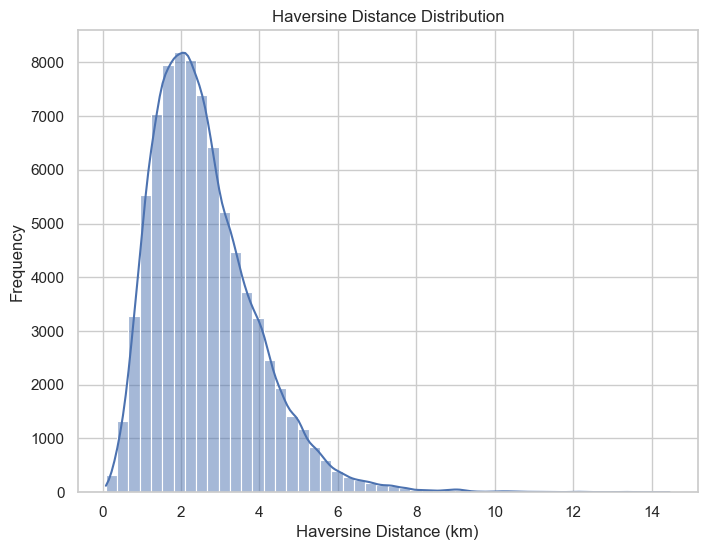

In [33]:
# plot a histogram for HaversineDistance
plt.figure(figsize=(8, 6))
sns.histplot(trips['HaversineDistance'], kde=True, bins=50)
plt.title('Haversine Distance Distribution')
plt.xlabel('Haversine Distance (km)')
plt.ylabel('Frequency')
plt.show()


In [34]:
# Define the thresholds for short, medium, and long trips
short_threshold = 2  # kilometers
medium_threshold = 5  # kilometers

# Define a function to categorize the distances
def categorize_distance(distance):
    if distance <= short_threshold:
        return 'Short'
    elif distance <= medium_threshold:
        return 'Medium'
    else:
        return 'Long'

# Apply the function to create a new column 'DistanceType'
trips['DistanceType'] = trips['HaversineDistance'].apply(categorize_distance)

In [35]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [36]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity', 'SpeedKmHrHav',
       'SpeedKmHrP', 'DistanceType'],
      dtype='object')

In [37]:
# Step 1: Calculate total trips per user and map it back to each row in the DataFrame
# This creates a Series where the index is the UserId from the original DataFrame, and the value is the count of trips per user
trip_counts = trips['UserId'].map(trips['UserId'].value_counts())

# Step 2: Define conditions and labels for binning directly on the trips DataFrame
conditions = [
    (trip_counts < 10),
    (trip_counts >= 10) & (trip_counts <= 39),
    (trip_counts >= 40)
]
labels = ['Occasional Users', 'Moderately Active Users', 'Active Users']

# Step 3: Use np.select to create the 'UserCategory' column based on these conditions
trips['UserCategory'] = np.select(conditions, labels, default='Unknown')
# CONVERT TO CATEGORY
trips['UserCategory'] = trips['UserCategory'].astype('category')


In [38]:
# value count usercategory
trips['UserCategory'].value_counts()

UserCategory
Occasional Users           43512
Moderately Active Users    26788
Active Users               11952
Name: count, dtype: int64

In [39]:
aggregated = trips[['UserId','HaversineDistance','Changes','SpeedKmHrHav','TripDurationMin', "UserCategory"]].groupby('UserId').agg(
    AvgKmDriven=('HaversineDistance', 'mean'),
    AvgSpeed=('SpeedKmHrHav', 'mean'),
    AvgChanges=('Changes', 'mean'),  # Assuming you want the average number of change  
    # Assuming you want the average trip duration
    AvgTripDuration=('TripDurationMin', 'mean'),
    Count=('UserId', 'count'),
    UserCategory = ('UserCategory', 'first')    
).reset_index()

In [40]:
# Drop duplicates to ensure one row per user
#user_categories = trips[['UserId', 'UserCategory']].drop_duplicates()

# Merge UserCategory back into the aggregated DataFrame
#aggregated = pd.merge(aggregated, user_categories, on='UserId', how='left')


In [41]:
custom_centroids = aggregated.groupby('UserCategory')[['AvgKmDriven', 'AvgSpeed', 'Count']].mean()
scaler = StandardScaler()
# Scale the centroids
features = aggregated[['AvgKmDriven', 'AvgSpeed', 'Count']]
scaler.fit(features)  # Make sure this is the same scaler used for your feature scaling
custom_centroids_scaled = scaler.transform(custom_centroids)


features_scaled = scaler.fit_transform(features)


# wcss = []
# for i in range(1, 11):  # Test k from 1 to 10
#     kmeans = KMeans(n_clusters=i, init=custom_centroids_scaled, n_init=1, random_state=42,)
#     kmeans.fit(features_scaled)
#     wcss.append(kmeans.inertia_)

# # Plot the Elbow graph
# plt.plot(range(1, 11), wcss)
# plt.title('Elbow Method')
# plt.xlabel('Number of clusters')
# plt.ylabel('WCSS')
# plt.show()


C:\Users\mihai\AppData\Local\Temp\ipykernel_33248\3798110794.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  custom_centroids = aggregated.groupby('UserCategory')[['AvgKmDriven', 'AvgSpeed', 'Count']].mean()


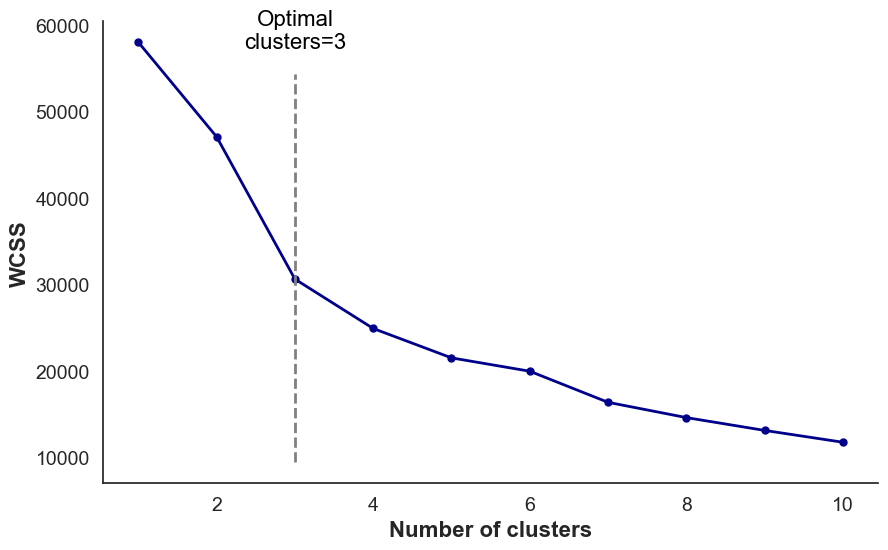

In [88]:
# Scale the features
features = aggregated[['AvgKmDriven','AvgSpeed', 'Count']]
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

wcss = []
for i in range(1, 11):  # Test k from 1 to 10
    kmeans = KMeans(n_clusters=i, n_init='auto', random_state=42)
    kmeans.fit(features_scaled)
    wcss.append(kmeans.inertia_)

sns.set(style="white")  # Set the seaborn style to white background

plt.figure(figsize=(10, 6))  # Set the figure size
plt.plot(range(1, 11), wcss, color='darkblue', linewidth=2, marker='o', markersize=5)  # Plot the WCSS curve
#plt.title('Elbow Method', fontsize=16)  # Set the title
plt.xlabel('Number of clusters', fontweight = 'bold', fontsize=16)  # Set the x-axis label
plt.ylabel('WCSS', fontweight = 'bold', fontsize=16)  # Set the y-axis label
# Calculate the y limits for 85% height of the axvline
y_min, y_max = plt.ylim()
y_lim = (y_min, y_max*0.9)
# set xticks font size
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

# Draw a vertical line at x=3 with custom y limits
plt.vlines(x=3, ymin=y_lim[0], ymax=y_lim[1], colors='gray', linestyles='--', linewidth=2)

# Optionally, you can add annotations to mark the optimal number of clusters
plt.text(3, y_max * 0.95, 'Optimal\nclusters=3', color='black', horizontalalignment='center', fontsize=16)
sns.despine()
plt.show()

In [43]:
custom_centroids.head()

,AvgKmDriven,AvgSpeed,Count
UserCategory,,,
Active Users,2.663366,8.437730,66.033149
Moderately Active Users,2.566642,7.720035,16.837209
Occasional Users,2.573044,6.293378,2.478187


In [44]:
# see the labels for the best k
kmeans = KMeans(n_clusters=3, init=custom_centroids_scaled, n_init='auto', random_state=42, max_iter=500,)
kmeans.fit(features_scaled)
labels = kmeans.labels_

In [45]:
# add labels to the aggregated dataframe
aggregated['UserCluster'] = labels

In [46]:
aggregated.head()

,UserId,AvgKmDriven,AvgSpeed,AvgChanges,AvgTripDuration,Count,UserCategory,UserCluster
0,1,1.062664,5.007985,0.045455,13.548147,22,Moderately Active Users,2
1,14,1.606272,5.895714,0.142857,17.354908,7,Occasional Users,2
2,16,3.082477,9.223394,0.000000,18.905784,100,Active Users,0
3,17,2.577818,7.299748,0.000000,24.746980,5,Occasional Users,1
4,56,2.761952,8.456030,0.125000,19.035076,8,Occasional Users,1


In [47]:
# joint aggregated Cluster column to trips based on UserId
trips = trips.merge(aggregated[['UserId','UserCluster']], on='UserId', how='left')

In [48]:
trips.head()

,StartTime,EndTime,UserId,latitudeStart,longitudeStart,nameStart,latitudeEnd,longitudeEnd,nameEnd,StartHubClusterId,EndHubClusterId,StartClusterName,EndClusterName,StartClusterLatitude,StartClusterLongitude,EndClusterLatitude,EndClusterLongitude,HaversineDistance,Month,StartHour,Weekday,TripDurationMin,TripDurationHr,SpeedKmHr,RoundTrip,Route,YearMonth,DurationGroup,StartTimeUpdated,TotalDurationMin,TripDistanceKm,TotalWalkingTimeMin,TotalTransitTimeMin,Changes,PickupStationProximity,DropoffStationProximity,SpeedKmHrHav,SpeedKmHrP,DistanceType,UserCategory,UserCluster
0,2018-03-01 17:43:14.707445,2018-03-01 18:14:12.145000,108186,55.673440,12.564409,Central Station,55.658239,12.605434,Skotlands Plads,590,331,Central Station,Skotlands Plads,55.673117,12.564212,55.658397,12.605787,3.078446,March,17,Thursday,30.957293,0.515955,6.008277,False,Central Station -> Skotlands Plads,2018-03,0-1 hour,2023-11-16 17:43:14.707445,17.500000,3.86560,6.500000,11.0,0.0,324.78,125.35,5.966503,7.492128,Medium,Occasional Users,1
1,2018-03-03 13:22:27.557683,2018-03-03 13:40:09.817000,109897,55.673668,12.571551,H. C. Andersens Blvd.,55.668555,12.547020,Broagergade,579,564,Ved Glyptoteket,Broagergade,55.672956,12.570784,55.669073,12.546464,1.640003,March,13,Saturday,17.704322,0.295072,10.505909,False,Ved Glyptoteket -> Broagergade,2018-03,0-1 hour,2023-11-18 13:22:27.557683,15.533333,2.69815,10.533333,5.0,0.0,80.07,677.63,5.557974,9.144038,Short,Occasional Users,2
2,2018-03-06 07:45:32.192047,2018-03-06 08:09:27.571000,1,55.672142,12.590571,Christianshavn,55.665808,12.578714,Egilsgade,50,542,Christianshavn,Egilsgade,55.672121,12.590597,55.665262,12.579198,1.024221,March,7,Tuesday,23.922983,0.398716,7.774950,False,Christianshavn -> Egilsgade,2018-03,0-1 hour,2023-11-21 07:45:32.192047,15.233333,1.87281,14.233333,1.0,0.0,100.86,538.09,2.568796,4.697098,Short,Moderately Active Users,2
3,2018-03-07 09:14:43.451300,2018-03-07 09:44:31.006000,14,55.682597,12.571227,Nørreport St.,55.666573,12.580692,Founders House,40,538,Nørreport St.,Founders House,55.683061,12.570524,55.666721,12.579745,1.878027,March,9,Wednesday,29.792578,0.496543,6.243166,False,Nørreport St. -> Founders House,2018-03,0-1 hour,2023-11-15 09:14:43.451300,22.550000,4.49931,12.333333,8.0,1.0,190.22,116.28,3.782205,9.061270,Short,Occasional Users,2
4,2018-03-08 08:57:15.603150,2018-03-08 09:33:33.622000,114469,55.668653,12.543646,Vega,55.701914,12.533708,Frederikssundsvej,562,267,Vega,Frederikssundsvej,55.668626,12.543944,55.702002,12.533122,3.750543,March,8,Thursday,36.300314,0.605005,5.123923,False,Vega -> Frederikssundsvej,2018-03,0-1 hour,2023-11-16 08:57:15.603150,23.733333,5.81268,13.733333,10.0,0.0,267.99,375.18,6.199191,9.607652,Medium,Occasional Users,1


In [49]:
trips.UserCluster.value_counts()

UserCluster
1    33806
2    31189
0    17257
Name: count, dtype: int64

C:\Users\mihai\AppData\Local\Temp\ipykernel_33248\159501738.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  trips.groupby('UserCategory')['UserCluster'].value_counts(normalize=True).unstack().plot(kind='bar', stacked=True, figsize=(10, 6))


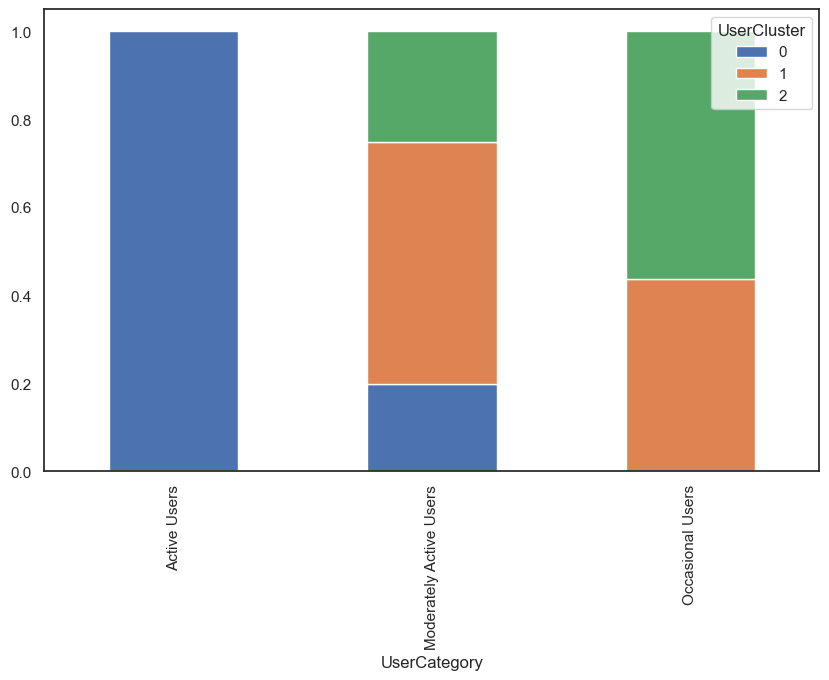

In [50]:
# groupby UserCategory and count Cluster
trips.groupby('UserCategory')['UserCluster'].value_counts(normalize=True).unstack().plot(kind='bar', stacked=True, figsize=(10, 6))
plt.show()

In [51]:
trips.groupby('UserCluster')['UserCategory'].value_counts().reset_index()

,UserCluster,UserCategory,count
0,0,Active Users,11952
1,0,Moderately Active Users,5305
2,0,Occasional Users,0
3,1,Occasional Users,19053
4,1,Moderately Active Users,14753
5,1,Active Users,0
6,2,Occasional Users,24459
7,2,Moderately Active Users,6730
8,2,Active Users,0


### Proximity and Mode Choice
How does the closeness to bike-sharing stations versus public transport stops influence individuals' transportation choices?


Given this setup, we can plot the distribution of these proximity measures to understand their influence on the mode choice. A compelling visualization for this purpose would be a dual histogram or KDE plot that shows the distribution of distances to the nearest public transport station for both pickup and dropoff points, highlighting the range of distances where bike-sharing might be more preferred.

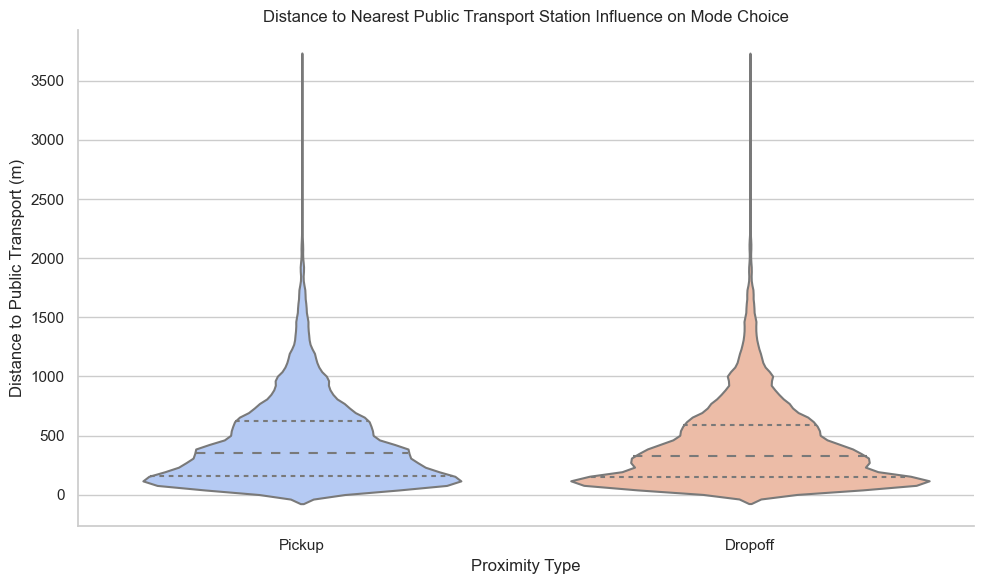

In [52]:
# Let's melt the DataFrame to have a long-form DataFrame suitable for our plotting
df_melted = pd.melt(trips, value_vars=['PickupStationProximity', 'DropoffStationProximity'], var_name='ProximityType', value_name='DistanceToPublicTransport')

# Plotting
plt.figure(figsize=(10, 6))
sns.set_theme(style="whitegrid", palette="muted")
ax = sns.violinplot(x='ProximityType', y='DistanceToPublicTransport', data=df_melted, inner="quartile", palette="coolwarm", native_scale=True)
sns.despine()

plt.title('Distance to Nearest Public Transport Station Influence on Mode Choice')
plt.ylabel('Distance to Public Transport (m)')
plt.xlabel('Proximity Type')
plt.xticks([0, 1], ['Pickup', 'Dropoff'])
plt.tight_layout()

plt.show()


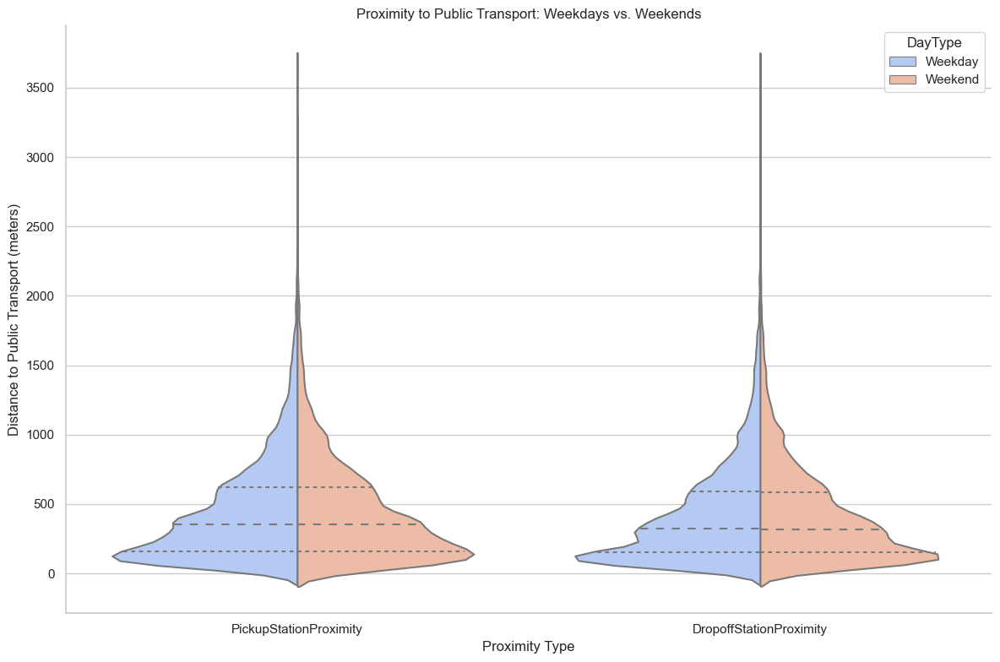

In [53]:
# To incorporate weekdays vs weekends, we first need to classify the 'Weekday' column appropriately
# Assuming 'Weekday' contains numeric values representing days of the week (e.g., 0 for Monday, 6 for Sunday)
# We will create a new column 'DayType' to categorize days into 'Weekday' and 'Weekend'

# To incorporate weekdays vs weekends, we first need to classify the 'Weekday' column appropriately
# Assuming 'Weekday' contains words representing days of the week (e.g., 'Monday', 'Tuesday', etc.)
# We will create a new column 'DayType' to categorize days into 'Weekday' and 'Weekend'

# Mapping of weekdays to their respective categories
weekday_mapping = {
    'Monday': 'Weekday',
    'Tuesday': 'Weekday',
    'Wednesday': 'Weekday',
    'Thursday': 'Weekday',
    'Friday': 'Weekday',
    'Saturday': 'Weekend',
    'Sunday': 'Weekend'
}

# Categorize 'Weekday' into 'Weekday' and 'Weekend'
trips['DayType'] = trips['Weekday'].map(weekday_mapping)

# Correctly merging the 'DayType' information with the melted DataFrame
# The issue likely arose from how 'DayType' was joined with 'df_melted'
# Ensure 'DayType' is correctly included for each row in 'df_melted'

# Melt the DataFrame again to ensure a clean start
df_melted_correct = pd.melt(trips, id_vars=['DayType'], value_vars=['PickupStationProximity', 'DropoffStationProximity'], 
                            var_name='ProximityType', value_name='DistanceToPublicTransport')

# Now, let's try plotting again
plt.figure(figsize=(12, 8))
sns.violinplot(x='ProximityType', y='DistanceToPublicTransport', hue='DayType',
               data=df_melted_correct, inner="quart", palette="coolwarm", split=True)
plt.title('Proximity to Public Transport: Weekdays vs. Weekends')
plt.xlabel('Proximity Type')
plt.ylabel('Distance to Public Transport (meters)')
sns.despine()

plt.tight_layout()
plt.show()



In [54]:
df_melted.head()

,ProximityType,DistanceToPublicTransport
0,PickupStationProximity,324.78
1,PickupStationProximity,80.07
2,PickupStationProximity,100.86
3,PickupStationProximity,190.22
4,PickupStationProximity,267.99


In [55]:
# Using df_melted_correct as the DataFrame
fig = px.violin(df_melted_correct, x='ProximityType', y='DistanceToPublicTransport', color='DayType',
                box=True, points="outliers",
                title='Distance to Nearest Public Transport Station: Weekdays vs. Weekends',
                labels={'ProximityType': 'Proximity Type', 'DistanceToPublicTransport': 'Distance to Public Transport (m)'},
                category_orders={'ProximityType': ['PickupStationProximity', 'DropoffStationProximity'], 'DayType': ['Weekday', 'Weekend']},
                violinmode='overlay')  # Note: Corrected 'violinmode' from 'overalay' to 'overlay'

fig.update_traces(meanline_visible=True)
fig.update_layout(showlegend=True, width=700, height=800, legend=dict(x=0.5, y=1.05))

fig.show()


c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  sf: grouped.get_group(s if len(s) > 1 else s[0])


The violin plot above illustrates the distribution of distances to the nearest public transport station for both pickup and dropoff locations. The distribution provides insights into the typical proximity of bike-sharing trips to public transport stations, which can help infer the role of station accessibility in transportation mode selection.

Key observations from the plot might include:
- The spread of distances, indicating the range within which most bike-sharing stations are located from public transport stops.
- The median distance, highlighted by the inner quartile marker, showing the most common proximity to public transport stations.
- Any differences in the distribution between pickup and dropoff locations, which might suggest varying accessibility or user preferences at the start vs. the end of trips.

This visualization can serve as a basis for further analysis on how proximity to public transport influences the choice of bike-sharing, potentially guiding infrastructure planning or improvements to the bike-sharing system to better complement public transport networks.

In [56]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity', 'SpeedKmHrHav',
       'SpeedKmHrP', 'DistanceType', 'UserCategory', 'UserCluster', 'DayType'],
      dtype='object')

### Violin Plot Analysis
The violin plot provides a detailed view of the distribution of distances to the nearest public transport station for both pickup and dropoff points. Here are some key observations and comments:

- **Distribution Shape**: The violin plot combines aspects of a box plot with a kernel density plot, showing the distribution's thickness at different points. This shape can indicate where the data is concentrated and where it tapers off, providing a visual representation of the density of proximity measures.
- **Median and Quartiles**: The inner markers show the median and quartiles, offering insights into the central tendency and spread of the data. These markers can help identify the typical distance to public transport stations for users when starting or ending their bike trips.
- **Symmetry and Outliers**: The symmetry of each violin plot can indicate the skewness of the distribution, while the width indicates the variability of distances. If there were any outliers or extreme values, they might be represented by the tails of the violins, although they're more abstract in this visualization.
- **Comparison Between Pickup and Dropoff**: The side-by-side placement allows for a direct comparison of pickup and dropoff station proximities. Any significant differences in the shapes, widths, or median positions could suggest varying preferences or accessibility issues at the start versus the end of trips.

### KDE Plot Analysis
The KDE plot overlays the density estimates for pickup and dropoff station proximities, providing a smooth representation of the data distribution. Here are some insights from the KDE plot:

- **Density Peaks**: The peaks of the KDE plot represent the most common distances to public transport stations for pickups and dropoffs. A higher peak suggests a higher concentration of data points around that distance, indicating a preference or higher likelihood of bike-sharing usage at those proximities.
- **Spread and Overlap**: The spread of the KDE curves shows the range of distances covered by bike-sharing users, while the overlap between the pickup and dropoff distributions can indicate similarities in proximity preferences for both trip endpoints.
- **Comparison of Preferences**: By comparing the two curves, we can infer if there's a distinct preference for bike-sharing usage closer to or further from public transport stations, depending on whether the trip is starting or ending. The relative height and width of the curves can also suggest which part of the trip (start or end) has a more flexible or constrained choice in proximity to public transport.

### Overall Comments
Both plots provide valuable insights into how the proximity to public transport stations influences bike-sharing usage. The violin plot offers a detailed look at the distribution's structure, including its central tendency and variability, while the KDE plot provides a smooth and continuous view of the density of proximity measures, allowing for easy comparison between pickup and dropoff distributions. Together, these visualizations help elucidate the relationship between bike-sharing system usage and public transport accessibility, supporting data-driven decisions for urban planning and transportation system integration.

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



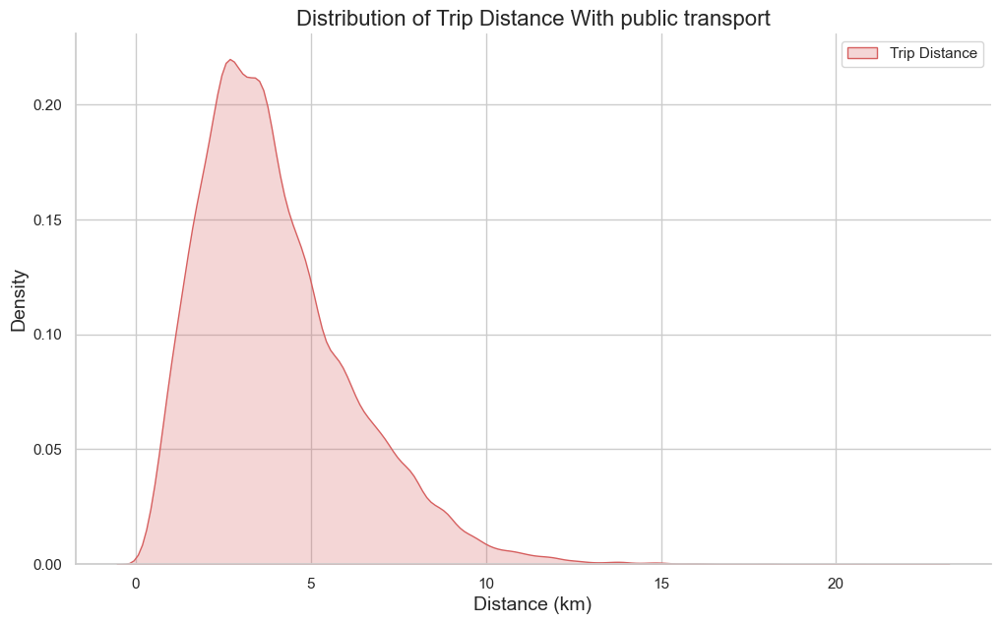

In [57]:
# plot the distribution of TripDistanceKm from public transport stations
plt.figure(figsize=(12, 7))
sns.kdeplot(trips['TripDistanceKm'], fill=True, color="r", label="Trip Distance")
plt.title('Distribution of Trip Distance With public transport', fontdict={'fontsize': 16})
plt.xlabel('Distance (km)', fontdict={'fontsize': 14})
plt.ylabel('Density', fontdict={'fontsize': 14})
plt.legend()

sns.despine()
plt.show()


2. **Total Trip Time Comparison**
   - **Existing Data**: 'TripDurationMin', 'TotalDurationMin' (assuming this includes waiting and walking times for public transport)
   - **Improvement**: Ensure the comparison accounts for all components of travel time, including initial access, in-vehicle time, transfers, and final egress. Additional data on average waiting times for public transport could enhance this analysis.
   

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



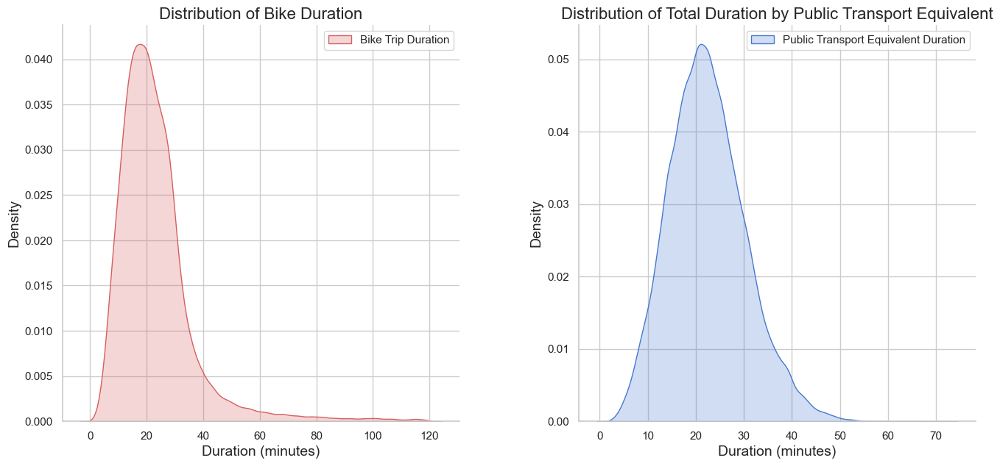

In [58]:
# plot the distribution of TripDurationMin and TotalDurationMin (which is the Car equivalent)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 7))

# Plot for TripDurationMin
sns.kdeplot(trips['TripDurationMin'], fill=True, color="r", label="Bike Trip Duration", ax=axes[0])
axes[0].set_title('Distribution of Bike Duration', fontdict={'fontsize': 16})
axes[0].set_xlabel('Duration (minutes)', fontdict={'fontsize': 14})
axes[0].set_ylabel('Density', fontdict={'fontsize': 14})
axes[0].legend()

# Plot for TotalDurationMin
sns.kdeplot(trips['TotalDurationMin'], fill=True, color="b", label="Public Transport Equivalent Duration", ax=axes[1])
axes[1].set_title('Distribution of Total Duration by Public Transport Equivalent', fontdict={'fontsize': 16})
axes[1].set_xlabel('Duration (minutes)', fontdict={'fontsize': 14})
axes[1].set_ylabel('Density', fontdict={'fontsize': 14})
axes[1].legend()

# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.3)

sns.despine()
plt.show()

In [59]:
# Assuming 'trips' is your DataFrame and it includes 'TripDurationMin' and 'TotalDurationMin' columns
# First, reshape the DataFrame to long format
long_df = pd.melt(trips, value_vars=['TripDurationMin', 'TotalDurationMin'], 
                  var_name='DurationType', value_name='Duration')

# Now, plot with the adjusted DataFrame
fig = px.violin(long_df, y='Duration', x='DurationType', box=True, points='outliers',
                color='DurationType',  # This will differentiate the colors based on the duration type
                color_discrete_map={'TripDurationMin': 'red', 'TotalDurationMin': 'blue'})  # Custom color for each type

fig.update_layout(title='Distribution of Bike and Car Equivalent Durations',
                  xaxis_title='Duration Type',
                  yaxis_title='Duration (minutes)',
                  xaxis=dict(tickmode='array', tickvals=[0, 1], ticktext=['Bike Trip Duration', 'Car Equivalent Duration']),
                legend_title='Duration Type', width=800, height=600)

fig.show()


c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [60]:
# Descbriptive statistics for TripDurationMin and TotalDurationMin
trips[['TripDurationMin', 'TotalDurationMin']].describe()

,TripDurationMin,TotalDurationMin
count,82252.000000,82252.000000
mean,23.173378,22.396652
std,13.995551,7.953310
min,1.042302,1.850000
25%,14.647366,16.783333
50%,20.624985,21.850000
75%,27.661646,27.366667
max,119.918954,72.016667


In [61]:
# compare TripDurationMin and TotalDurationMin 
duration_desc = trips[['TripDurationMin','TotalDurationMin']].describe()


In [62]:
duration_desc

,TripDurationMin,TotalDurationMin
count,82252.000000,82252.000000
mean,23.173378,22.396652
std,13.995551,7.953310
min,1.042302,1.850000
25%,14.647366,16.783333
50%,20.624985,21.850000
75%,27.661646,27.366667
max,119.918954,72.016667


In [63]:
# get the percentage difference between TripDurationMin and TotalDurationMin from duration_desc
duration_desc['Difference (%)'] = (duration_desc['TripDurationMin'] - duration_desc['TotalDurationMin'])/duration_desc['TripDurationMin']


In [64]:
# cut the 1st column from duration_desc
duration_desc

,TripDurationMin,TotalDurationMin,Difference (%)
count,82252.000000,82252.000000,0.000000
mean,23.173378,22.396652,0.033518
std,13.995551,7.953310,0.431726
min,1.042302,1.850000,-0.774918
25%,14.647366,16.783333,-0.145826
50%,20.624985,21.850000,-0.059395
75%,27.661646,27.366667,0.010664
max,119.918954,72.016667,0.399456


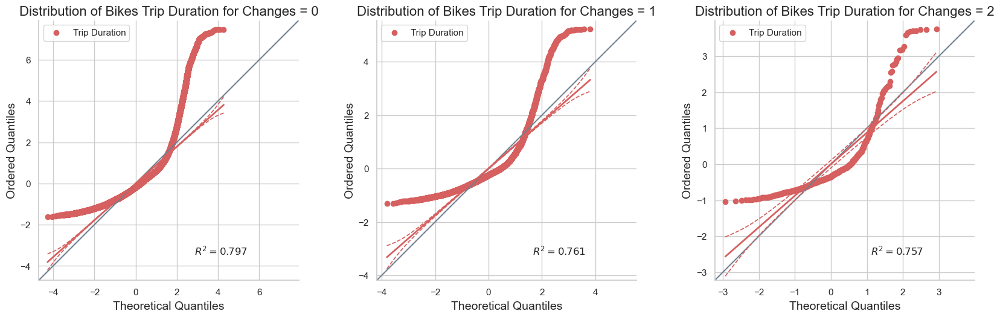

In [65]:
import pingouin as pg
# Define the values of Changes
changes_values = [0, 1, 2]

# Create the subplots
fig, axes = plt.subplots(nrows=1, ncols=len(changes_values), figsize=(20, 7))

# Iterate over the values of Changes
for i, changes in enumerate(changes_values):
    # Plot the qqplot for TripDurationMin
    pg.qqplot(trips[trips['Changes'] == changes]['TripDurationMin'], ax=axes[i], color="r", label="Trip Duration")
    
    # Set the title, x-axis label, and y-axis label for each subplot
    axes[i].set_title(f'Distribution of Bikes Trip Duration for Changes = {changes}', fontdict={'fontsize': 16})
    axes[i].set_xlabel('Theoretical Quantiles', fontdict={'fontsize': 14})
    axes[i].set_ylabel('Ordered Quantiles', fontdict={'fontsize': 14})
    axes[i].legend()

# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.3)

sns.despine()
plt.show()


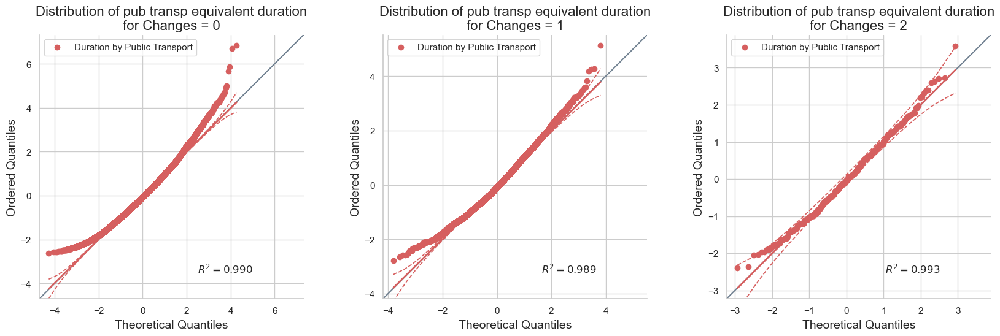

In [66]:
changes_values = [0, 1, 2]

# Create the subplots
fig, axes = plt.subplots(nrows=1, ncols=len(changes_values), figsize=(20, 7))

# Iterate over the values of Changes
for i, changes in enumerate(changes_values):
    # Plot the qqplot for TotalDurationMin (public transport equivalent)
    pg.qqplot(trips[trips['Changes'] == changes]['TotalDurationMin'], ax=axes[i], color="r", label="Duration by Public Transport")
    
    # Set the title, x-axis label, and y-axis label for each subplot
    axes[i].set_title(f'Distribution of pub transp equivalent duration\nfor Changes = {changes}', fontdict={'fontsize': 16})
    axes[i].set_xlabel('Theoretical Quantiles', fontdict={'fontsize': 14})
    axes[i].set_ylabel('Ordered Quantiles', fontdict={'fontsize': 14})
    axes[i].legend()

# Adjust the spacing between subplots
plt.subplots_adjust(wspace=0.3)

sns.despine()
plt.show()

A Q-Q (quantile-quantile) plot is a graphical tool to help us assess if a dataset follows a certain theoretical distribution. It plots the quantiles of the data against the quantiles of the chosen theoretical distribution. If the data follow the selected distribution, the points on the Q-Q plot will approximately lie on the line y = x.

Here's how to interpret a Q-Q plot generated by Pingouin:

- **Theoretical Quantiles (x-axis)**: These are the quantiles from the theoretical distribution you are comparing your data to, often the standard normal distribution.

- **Ordered Values (y-axis)**: These are the quantiles from your data.

- **R² (coefficient of determination)**: This is a statistical measure that represents the proportion of the variance for a dependent variable that's explained by an independent variable or variables in a regression model. If the R² of a model is 0.50, then approximately half of the observed variation can be explained by the model's inputs.

- **Red dotted lines**: These are the 95% confidence intervals. If the data points fall within these lines, it suggests that the data is normally distributed.

- **Red line in the middle**: This is the line of equality (y = x). If the data follows the theoretical distribution, the points should fall along this line.

- **Blue line**: This is the line of best fit through the data points. If this line closely follows the red line (y = x), it suggests that the data is normally distributed.

In summary, if the blue line (line of best fit) closely follows the red line (line of equality) and most points fall within the red dotted lines (95% confidence intervals), it suggests that your data is normally distributed. If the points deviate from the line of equality, it suggests that your data may not be normally distributed. The R² value gives you a measure of how closely your data follow the theoretical distribution: a higher R² suggests a better fit to the normal distribution.

3. **Transfers and Time Penalties**
   - **Existing Data**: 'Changes' (assumed to refer to public transport transfers)
   - **Improvement**: Analyze the impact of transfers on total trip time and user preference. Data on specific transfer penalties and waiting times would be beneficial.

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



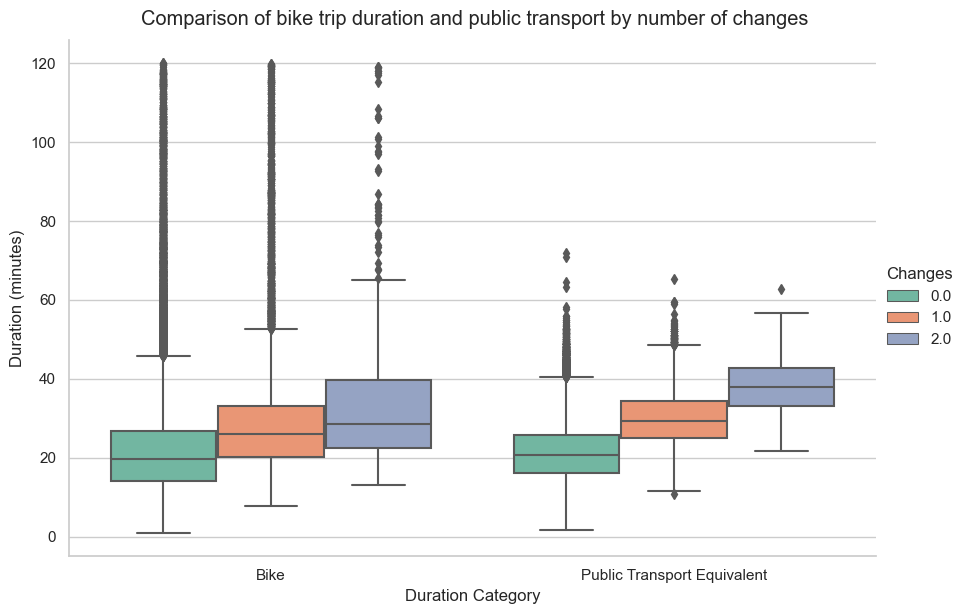

In [67]:
# Convert 'Changes' to categorical type
trips['Changes'] = trips['Changes'].astype('category')

# Preparing the data: Since sns.catplot does not support direct comparison of two columns in the way px.box does,
# we need to melt the DataFrame
trips_melted = pd.melt(trips, id_vars=['Changes'], value_vars=['TripDurationMin', 'TotalDurationMin'],
                    var_name='DurationType', value_name='Duration')

# Creating the catplot with boxplots
g = sns.catplot(x='DurationType', y='Duration', hue='Changes', data=trips_melted, kind='box',
                height=6, aspect=1.5, palette='Set2')

g.fig.suptitle('Comparison of bike trip duration and public transport by number of changes', y=1.02)
g.set_axis_labels('Duration Category', 'Duration (minutes)')
# set xticks
g.set_xticklabels(['Bike', 'Public Transport Equivalent'])
g.set_titles("{col_name}")

plt.show()


In [68]:
trips_melted

,Changes,DurationType,Duration
0,0.0,TripDurationMin,30.957293
1,0.0,TripDurationMin,17.704322
2,0.0,TripDurationMin,23.922983
3,1.0,TripDurationMin,29.792578
4,0.0,TripDurationMin,36.300314
...,...,...,...
164499,0.0,TotalDurationMin,17.033333
164500,0.0,TotalDurationMin,19.716667
164501,0.0,TotalDurationMin,10.116667
164502,0.0,TotalDurationMin,16.350000


In [69]:
import plotly.figure_factory as ff
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from scipy import stats

# Assuming 'trips_melted' DataFrame and 'Changes' and 'DurationType' columns are defined

# Define colors for each duration type
colors = ['#1f77b4', 'orange']

# Create subplots with 1 row and 3 columns
fig = make_subplots(rows=1, cols=3, horizontal_spacing=0.04, subplot_titles=['Changes: 0', 'Changes: 1', 'Changes: 2'])
# Loop through each category and create distplots
for i, category in enumerate(sorted(trips_melted['Changes'].unique())):
    # Filter data for the category and duration type
    category_data = trips_melted[trips_melted['Changes'] == category]
    bike_duration_data = category_data[category_data['DurationType'] == "TripDurationMin"]['Duration']
    public_transport_duration_data = category_data[category_data['DurationType'] == "TotalDurationMin"]['Duration']
    # Define the desired number of bins
    desired_nbins = 30

    # Calculate the range of your data (max - min)
    start = min(bike_duration_data.min(), public_transport_duration_data.min())
    end = max(bike_duration_data.max(), public_transport_duration_data.max())
    data_range = end - start

    # Calculate the bin size based on the desired number of bins
    bin_size = data_range / desired_nbins
    # Create distplots for the current category
    hist_data = [bike_duration_data, public_transport_duration_data]
    group_labels = [f'Bike Duration', f'Public Transport Duration']
    distplot_fig = ff.create_distplot(hist_data, group_labels,  show_hist=True, show_rug=False, colors=colors, bin_size=bin_size)
    
    # Extract the traces from the distplot and add them to the subplots
    for j, trace in enumerate(distplot_fig['data']):
        show_legend = (i == 0) and (j < 2)  # Show legend only for the first subplot and first two traces
        fig.add_trace(trace, row=1, col=i+1, )
        fig.data[-1].update(showlegend=show_legend)
    
    # Perform Shapiro-Wilk test (sample size limited to 5000)
    shapiro_bike = stats.shapiro(bike_duration_data.sample(min(5000, len(bike_duration_data))))
    shapiro_public_transport = stats.shapiro(public_transport_duration_data.sample(min(5000, len(public_transport_duration_data))))

    
    # Calculate histograms using numpy
    hist_bike, _ = np.histogram(bike_duration_data, bins=desired_nbins, density = True)
    hist_public_transport, _ = np.histogram(public_transport_duration_data, bins=desired_nbins, density = True)
    
    # Find the maximum y-value (count) for each histogram and store it
    max_y_bike = np.max(hist_bike)
    max_y_public_transport = np.max(hist_public_transport)
    
    # Store the larger of the two maximum y-values
    max_y_value = max(max_y_bike, max_y_public_transport)

    fig.add_annotation(
        text=f"Bike Normality p-value: {shapiro_bike.pvalue:.3f}",
        xref=f"x{i+1}", yref="paper",
        x=end,
        y=0.98,
        showarrow=False,
        font=dict(size=12, color='#1f77b4'),
        align="right",
        bgcolor="rgba(255, 255, 255, 0.9)",
        xanchor='right',
        yanchor='top'
    )
    fig.add_annotation(
        text=f"Public T Normality p-value: {shapiro_public_transport.pvalue:.3f}",
        xref=f"x{i+1}", yref='paper',
        x=end,
        y=0.95,
        showarrow=False,
        font=dict(size=12, color="orange"),
        align="right",
        bgcolor="rgba(255, 255, 255, 0.9)",
        xanchor='right',
        yanchor='top'
    )

# Update layout
fig.update_layout(
    margin=dict(l=20, r=20, t=100, b=20),
    title= dict(font = dict(size=22), text='Distribution of Duration by Change and Duration Type', x = 0.5, xanchor = 'center', y = 0.98),
    height=650, width=1200,
    legend=dict(orientation="h", yanchor="top", y=1.1, x=0.5, traceorder='normal', xanchor='center'),
    bargap=0.05,  # Add some space between bars
    barmode='overlay',  # Enable overlay mode for histograms
)
fig.update_xaxes(title_text='Duration', row=1, col=2, title_font=dict(size=18))
fig.update_yaxes(title_text='Density', row=1, col=1, title_font=dict(size=18))
# Show the figure
fig.show()
# save the figure as png in high quality in current directory
#fig.write_image("bike_duration_kde.png", scale=3)


In [70]:
# describe the TripDurationMin
trips['TripDurationMin'].describe()

count    82252.000000
mean        23.173378
std         13.995551
min          1.042302
25%         14.647366
50%         20.624985
75%         27.661646
max        119.918954
Name: TripDurationMin, dtype: float64

In [71]:

'''
# Assuming 'trips' DataFrame is defined and contains 'UserCategory', 'HaversineDistance', and 'SpeedKmHrHav' columns

# Initialize an empty list to store the results
shapiro_results = []

# Loop through each unique category to perform the Shapiro-Wilk test
for category in trips['Changes'].unique():
    # Sample data if necessary to meet Shapiro-Wilk test limitations
    hav_data = trips[trips['Changes'] == category]['TripDurationMin']
    speed_data = trips[trips['Changes'] == category]['TotalDurationMin']
    
    if len(hav_data) > 5000:
        hav_data = hav_data.sample(5000, random_state=1)
    if len(speed_data) > 5000:
        speed_data = speed_data.sample(5000, random_state=1)
    
    # Perform the Shapiro-Wilk test
    stat_hav, p_hav = stats.shapiro(hav_data)
    stat_speed, p_speed = stats.shapiro(speed_data)
    
    # Store the results
    shapiro_results.append((category, stat_hav, p_hav, stat_speed, p_speed))

# Convert the results into a DataFrame
shapiro_df = pd.DataFrame(shapiro_results, columns=['Changes', 'TripDurationMin(bike) Test Statistic', 'TripDurationMin(bike) p-value', 'TotalDurationMin(PubT) Test Statistic', 'TotalDurationMin(PubT) p-value']).round(4)

shapiro_df'''


"\n# Assuming 'trips' DataFrame is defined and contains 'UserCategory', 'HaversineDistance', and 'SpeedKmHrHav' columns\n\n# Initialize an empty list to store the results\nshapiro_results = []\n\n# Loop through each unique category to perform the Shapiro-Wilk test\nfor category in trips['Changes'].unique():\n    # Sample data if necessary to meet Shapiro-Wilk test limitations\n    hav_data = trips[trips['Changes'] == category]['TripDurationMin']\n    speed_data = trips[trips['Changes'] == category]['TotalDurationMin']\n    \n    if len(hav_data) > 5000:\n        hav_data = hav_data.sample(5000, random_state=1)\n    if len(speed_data) > 5000:\n        speed_data = speed_data.sample(5000, random_state=1)\n    \n    # Perform the Shapiro-Wilk test\n    stat_hav, p_hav = stats.shapiro(hav_data)\n    stat_speed, p_speed = stats.shapiro(speed_data)\n    \n    # Store the results\n    shapiro_results.append((category, stat_hav, p_hav, stat_speed, p_speed))\n\n# Convert the results into a Data

In [72]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity', 'SpeedKmHrHav',
       'SpeedKmHrP', 'DistanceType', 'UserCategory', 'UserCluster', 'DayType'],
      dtype='object')

In [73]:
trips.head()

,StartTime,EndTime,UserId,latitudeStart,longitudeStart,nameStart,latitudeEnd,longitudeEnd,nameEnd,StartHubClusterId,EndHubClusterId,StartClusterName,EndClusterName,StartClusterLatitude,StartClusterLongitude,EndClusterLatitude,EndClusterLongitude,HaversineDistance,Month,StartHour,Weekday,TripDurationMin,TripDurationHr,SpeedKmHr,RoundTrip,Route,YearMonth,DurationGroup,StartTimeUpdated,TotalDurationMin,TripDistanceKm,TotalWalkingTimeMin,TotalTransitTimeMin,Changes,PickupStationProximity,DropoffStationProximity,SpeedKmHrHav,SpeedKmHrP,DistanceType,UserCategory,UserCluster,DayType
0,2018-03-01 17:43:14.707445,2018-03-01 18:14:12.145000,108186,55.673440,12.564409,Central Station,55.658239,12.605434,Skotlands Plads,590,331,Central Station,Skotlands Plads,55.673117,12.564212,55.658397,12.605787,3.078446,March,17,Thursday,30.957293,0.515955,6.008277,False,Central Station -> Skotlands Plads,2018-03,0-1 hour,2023-11-16 17:43:14.707445,17.500000,3.86560,6.500000,11.0,0.0,324.78,125.35,5.966503,7.492128,Medium,Occasional Users,1,Weekday
1,2018-03-03 13:22:27.557683,2018-03-03 13:40:09.817000,109897,55.673668,12.571551,H. C. Andersens Blvd.,55.668555,12.547020,Broagergade,579,564,Ved Glyptoteket,Broagergade,55.672956,12.570784,55.669073,12.546464,1.640003,March,13,Saturday,17.704322,0.295072,10.505909,False,Ved Glyptoteket -> Broagergade,2018-03,0-1 hour,2023-11-18 13:22:27.557683,15.533333,2.69815,10.533333,5.0,0.0,80.07,677.63,5.557974,9.144038,Short,Occasional Users,2,Weekend
2,2018-03-06 07:45:32.192047,2018-03-06 08:09:27.571000,1,55.672142,12.590571,Christianshavn,55.665808,12.578714,Egilsgade,50,542,Christianshavn,Egilsgade,55.672121,12.590597,55.665262,12.579198,1.024221,March,7,Tuesday,23.922983,0.398716,7.774950,False,Christianshavn -> Egilsgade,2018-03,0-1 hour,2023-11-21 07:45:32.192047,15.233333,1.87281,14.233333,1.0,0.0,100.86,538.09,2.568796,4.697098,Short,Moderately Active Users,2,Weekday
3,2018-03-07 09:14:43.451300,2018-03-07 09:44:31.006000,14,55.682597,12.571227,Nørreport St.,55.666573,12.580692,Founders House,40,538,Nørreport St.,Founders House,55.683061,12.570524,55.666721,12.579745,1.878027,March,9,Wednesday,29.792578,0.496543,6.243166,False,Nørreport St. -> Founders House,2018-03,0-1 hour,2023-11-15 09:14:43.451300,22.550000,4.49931,12.333333,8.0,1.0,190.22,116.28,3.782205,9.061270,Short,Occasional Users,2,Weekday
4,2018-03-08 08:57:15.603150,2018-03-08 09:33:33.622000,114469,55.668653,12.543646,Vega,55.701914,12.533708,Frederikssundsvej,562,267,Vega,Frederikssundsvej,55.668626,12.543944,55.702002,12.533122,3.750543,March,8,Thursday,36.300314,0.605005,5.123923,False,Vega -> Frederikssundsvej,2018-03,0-1 hour,2023-11-16 08:57:15.603150,23.733333,5.81268,13.733333,10.0,0.0,267.99,375.18,6.199191,9.607652,Medium,Occasional Users,1,Weekday


In [86]:
# Reshape the data to long format
trips_melted = pd.melt(trips, id_vars=['Changes', 'UserId'], value_vars=['TripDurationMin', 'TotalDurationMin'], var_name='DurationType', value_name='Duration')

# Perform pairwise Wilcoxon tests
pairwise_results = pg.pairwise_tests(data=trips_melted, dv='Duration', within = 'DurationType',  between='Changes', subject='UserId', parametric=False, padjust='bonf').round(4)

C:\Users\mihai\AppData\Roaming\Python\Python311\site-packages\pingouin\pairwise.py:593: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [87]:
pairwise_results

,Contrast,DurationType,A,B,Paired,Parametric,U-val,W-val,alternative,p-unc,p-corr,p-adjust,hedges
0,DurationType,-,TotalDurationMin,TripDurationMin,True,False,NaN,65651167.0,two-sided,0.0,NaN,NaN,-0.3605
1,Changes,-,0.0,1.0,False,False,21008038.0,NaN,two-sided,0.0,0.0000,bonf,-0.8361
2,Changes,-,0.0,2.0,False,False,619869.0,NaN,two-sided,0.0,0.0000,bonf,-1.6403
3,Changes,-,1.0,2.0,False,False,416926.0,NaN,two-sided,0.0,0.0000,bonf,-0.6394
4,DurationType * Changes,TotalDurationMin,0.0,1.0,False,False,14889647.0,NaN,two-sided,0.0,0.0000,bonf,-1.3137
5,DurationType * Changes,TotalDurationMin,0.0,2.0,False,False,201427.0,NaN,two-sided,0.0,0.0000,bonf,-2.6085
6,DurationType * Changes,TotalDurationMin,1.0,2.0,False,False,266161.0,NaN,two-sided,0.0,0.0000,bonf,-1.2274
7,DurationType * Changes,TripDurationMin,0.0,1.0,False,False,30115266.0,NaN,two-sided,0.0,0.0000,bonf,-0.4730
8,DurationType * Changes,TripDurationMin,0.0,2.0,False,False,1466355.0,NaN,two-sided,0.0,0.0000,bonf,-0.9012
9,DurationType * Changes,TripDurationMin,1.0,2.0,False,False,573113.0,NaN,two-sided,0.0,0.0002,bonf,-0.3062


In [81]:
# Loop through each level of PubTChanges
all_results = pd.DataFrame()
for change in trips['Changes'].unique():
    subset = trips[trips['Changes'] == change]
    print(f"Change:{change}", subset[['TripDurationMin','TotalDurationMin']].mean())
    # Perform a paired t-test or Wilcoxon signed-rank test
    df = pg.ttest(subset['TripDurationMin'], subset['TotalDurationMin'], paired=True, alternative='two-sided').round(3)
    # concatenate df on df 
    # Add a column to 'df' indicating the current level of PubTChanges before concatenating
    df['Changes'] = change
    all_results = pd.concat([all_results, df], ignore_index=True)
all_results

Change:0.0 TripDurationMin     22.134961
TotalDurationMin    21.267333
dtype: float64
Change:1.0 TripDurationMin     30.237072
TotalDurationMin    30.013619
dtype: float64
Change:2.0 TripDurationMin     36.194270
TotalDurationMin    38.109506
dtype: float64


,T,dof,alternative,p-val,CI95%,cohen-d,BF10,power,Changes
0,19.758,72012,two-sided,0.000,"[0.78, 0.95]",0.081,1.448e+82,1.000,0.0
1,1.361,9826,two-sided,0.174,"[-0.1, 0.55]",0.017,0.029,0.395,1.0
2,-1.909,411,two-sided,0.057,"[-3.89, 0.06]",0.117,0.335,0.659,2.0


This is the paired pairwise test for pairder data. The Wilcoxon signed-rank test is a non-parametric statistical hypothesis test used to compare two related samples, matched samples, or repeated measurements on a single sample to assess whether their population mean ranks differ (i.e., it tests whether the distributions of the two samples differ).

  - analyze each area (zone), ex amager, center of cop, norrebro ...
  - the time it takes for both
  - see where people benefit more by taking the bikes
  - spacial analysis for each area and color code with differences

In [133]:
trips_melted.head()

,Changes,DurationType,Duration
0,0.0,TripDurationMin,30.957293
1,0.0,TripDurationMin,17.704322
2,0.0,TripDurationMin,23.922983
3,1.0,TripDurationMin,29.792578
4,0.0,TripDurationMin,36.300314


### Interpretation:

- **Changes**: The first three rows compare groups with different numbers of changes (0 vs 1, 0 vs 2, and 1 vs 2). The p-values (`p-unc`) are extremely low, indicating significant differences in durations across these groups. The Bonferroni-adjusted p-values (`p-corr`) confirm these findings remain significant even after adjustment for multiple comparisons. The effect sizes (`hedges`) suggest a small to moderate negative impact as the number of changes increases.
  
- **DurationType**: The comparison between `TotalDurationMin` and `TripDurationMin` without considering changes shows a highly significant difference (p < 0.0001), indicating that overall, trip durations and total durations are significantly different from each other.

- **Changes * DurationType**: This set of comparisons examines the differences between `TotalDurationMin` and `TripDurationMin` within each level of changes (0, 1, 2). For changes levels 0 and 1, there are highly significant differences between trip durations and total durations, suggesting that, generally, public transport durations are longer than bike trip durations for these levels of changes. For change level 2, the comparison is not statistically significant (p-unc = 0.2017, p-corr = 0.6051 after Bonferroni adjustment), indicating no significant difference between trip and total durations for trips with 2 changes.

The Bonferroni correction is a statistical adjustment method used to counteract the problem of multiple comparisons. When conducting multiple statistical tests simultaneously, the chance of incorrectly rejecting at least one true null hypothesis (Type I error) increases with the number of tests. The Bonferroni correction mitigates this issue by lowering the significance threshold for each individual test, thus controlling the overall Type I error rate across all tests.

The correction is straightforward: if you are performing $n$ comparisons and your significance level for each test is $\alpha$, the Bonferroni corrected significance level becomes $\frac{\alpha}{n}$. This method is conservative, ensuring that the familywise error rate (the probability of making one or more Type I errors in a family of tests) is kept at or below $\alpha$.

### Summary:

The two-sided pairwise comparisons reveal significant differences in durations between bike trips (`TripDurationMin`) and public transport (`TotalDurationMin`) for 0 and 1 changes, with very low p-values suggesting strong evidence of disparity. For 2 changes, no significant difference is detected, indicating similar durations for bike and public transport trips in this context.

### Conclusion:

Applying the Bonferroni correction for multiple comparisons, the analysis demonstrates that bike trip durations significantly differ from public transport durations when fewer changes are involved. However, for trips with 2 changes, durations converge, suggesting trip complexity influences the similarity in durations between these modes of transportation.

## 6. **Last-Mile Connectivity**
   - **Existing Data**: 'PickupStationProximity', 'DropoffStationProximity'
   - **Improvement**: Focus on the role of bike-sharing in enhancing access to public transport hubs. Data on public transport hub locations and their connectivity to final destinations would be useful.

    You can examine if shorter distances to public transport stops from bike-sharing stations correlate with increased bike-sharing usage, particularly for completing journeys that start or end at public transport hubs

Below is a Markdown text crafted for use in VS Code, incorporating LaTeX for mathematical notation where necessary. This description outlines the approach for analyzing last-mile connectivity in the context of bike-sharing and public transport integration.

---

# Last-Mile Connectivity Analysis

## Objective

The goal of this analysis is to investigate the role of bike-sharing in facilitating last-mile connectivity in urban environments. Specifically, we aim to understand how bike-sharing services complement public transport by serving as a first or last-mile solution for commuters. This involves analyzing bike pickups and dropoffs in proximity to public transport stations.

## Methodology

### Data Filtering

We separate the analysis into two main scenarios based on the proximity to public transport stations:

1. **Pickup Proximity**: Identifying trips where bikes are picked up within 500 meters of a public transport station. These represent potential first-mile connections.

    

2. **Dropoff Proximity**: Identifying trips where bikes are dropped off within 500 meters of a public transport station. These represent potential last-mile connections.

### Analysis Points

- **Frequency of Use**: Assess how frequently bike-sharing is used in conjunction with public transport, focusing on the start and end of the day.
  
- **Proximity Correlation**: Examine the relationship between the proximity to public transport stations and the usage of bike-sharing services.

- **Trip Characteristics**: Analyze the features of trips linked to public transport usage, including trip duration, distance, and timing.

## Expected Outcomes

Through this analysis, we aim to uncover insights into:

- The effectiveness of bike-sharing as a first and last-mile solution.
- Patterns of bike-sharing usage in relation to public transport hubs.
- Opportunities for enhancing urban mobility and public transport integration with bike-sharing services.

## Conclusion

Understanding last-mile connectivity's dynamics is crucial for improving urban transportation networks. This analysis seeks to provide valuable data-driven insights to support decision-making for urban planners and bike-sharing operators, ultimately enhancing the commuter experience in urban areas.

To perform a robust analysis of last-mile connectivity using bike-sharing data, and to validate that the trips are indeed serving as connections to public transport, we need to refine our approach and consider additional data or validation strategies. Here are some steps and considerations to enhance the analysis:

### 1. **Refine Last-Mile Trip Criteria**:
- **Exclude Dual Proximity**: Exclude trips that are close to public transport stations at both start and end points, as these might not represent typical last-mile connectivity but rather short loops around transport hubs or within residential areas.
- **Distance Thresholds**: Re-evaluate the distance criteria for defining last-mile trips. Consider adjusting the maximum acceptable `HaversineDistance` based on urban density and typical last-mile distances in the specific city.
- **Duration Thresholds**: Implement duration thresholds that more accurately reflect realistic biking times for last-mile distances, considering average biking speeds and urban traffic conditions.

### 2. **Incorporate Additional Data**:
- **Public Transport Schedules**: Incorporating public transport schedules could help validate if bike trips are temporally aligned with public transport arrivals or departures, supporting the hypothesis of last-mile connectivity.
- **User Demographics**: Understanding the demographics of bike-sharing users (if available) could provide insights into whether certain population segments are more likely to use bike-sharing for last-mile connectivity.
- **Trip Purpose Surveys**: Data from surveys on trip purpose could directly indicate whether users are leveraging bike-sharing for last-mile connectivity to public transport.

### 3. **Spatial Analysis**:
- **Geospatial Clustering**: Perform geospatial clustering of trip starts and ends to identify high-density areas of bike-sharing usage in proximity to public transport stations. This could help distinguish between residential area usage and genuine last-mile connectivity.
- **Public Transport Hub Proximity**: Distinguish between different types of public transport stations (e.g., major train stations vs. local bus stops) to refine the analysis of last-mile connectivity.

### 4. **Temporal Analysis**:
- **Peak Hours Analysis**: Analyze the timing of trips in relation to public transport peak hours to validate if increased bike-sharing usage correlates with commuter patterns.
- **Seasonal and Weather Considerations**: Consider how seasonal changes and weather conditions impact bike-sharing usage patterns related to public transport connectivity.

### 5. **Exclude Trips Within Both Proximities**:
Implement a filter to exclude trips that start and end within close proximity to public transport, as these may not represent genuine last-mile connectivity:

```python
df_filtered = df_no_round_trip[
    ((df_no_round_trip['PickupStationProximity'] <= 500) & (df_no_round_trip['DropoffStationProximity'] > 500)) |
    ((df_no_round_trip['PickupStationProximity'] > 500) & (df_no_round_trip['DropoffStationProximity'] <= 500))
]
```

### Conclusion:
A robust analysis of last-mile connectivity requires a multifaceted approach, considering both spatial and temporal dimensions, along with the integration of additional data sources. By refining the criteria for identifying last-mile trips and incorporating contextual data, the analysis can more accurately capture the role of bike-sharing in enhancing access to public transport. This comprehensive approach will provide deeper insights into urban mobility patterns and support informed decision-making for improving public transport integration with bike-sharing services.

In [134]:
trips.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 82252 entries, 0 to 82251
Data columns (total 42 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   StartTime                82252 non-null  object  
 1   EndTime                  82252 non-null  object  
 2   UserId                   82252 non-null  int64   
 3   latitudeStart            82252 non-null  float64 
 4   longitudeStart           82252 non-null  float64 
 5   nameStart                82252 non-null  object  
 6   latitudeEnd              82252 non-null  float64 
 7   longitudeEnd             82252 non-null  float64 
 8   nameEnd                  82252 non-null  object  
 9   StartHubClusterId        82252 non-null  int64   
 10  EndHubClusterId          82252 non-null  int64   
 11  StartClusterName         82252 non-null  object  
 12  EndClusterName           82252 non-null  object  
 13  StartClusterLatitude     82252 non-null  float64 
 14  StartC

### Function for plots


In [135]:
def plot_hourly_proximity(df, title='Average Proximity to Public Transport by Start Hour'):
    # Group and calculate mean
    hourly_proximity = df.groupby('StartHour')[['PickupStationProximity', 'DropoffStationProximity']].mean().reset_index()

    # Melt and rename for clarity
    hourly_proximity_melted = pd.melt(hourly_proximity, id_vars='StartHour', 
                                      value_vars=['PickupStationProximity', 'DropoffStationProximity'], 
                                      var_name='ProximityType', value_name='MeanProximity')
    hourly_proximity_melted['ProximityType'] = hourly_proximity_melted['ProximityType'].map({
        'PickupStationProximity': 'Pickup Proximity',
        'DropoffStationProximity': 'Dropoff Proximity'
    })

    # Define custom colors for lines
    color_discrete_map = {'Pickup Proximity': '#1f77b4', 'Dropoff Proximity': 'orange'}

    # Plot with customizations
    fig = px.line(hourly_proximity_melted, x='StartHour', y='MeanProximity', color='ProximityType', 
                  title=title, labels={'StartHour': 'Start Hour', 'MeanProximity': 'Average Proximity (meters)'},
                  category_orders={'ProximityType': ['Pickup Proximity', 'Dropoff Proximity']},
                  color_discrete_map=color_discrete_map)

    # Update layout for aesthetics
    fig.update_layout(title_x=0.5, legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1),
                      margin=dict(l=20, r=20, t=100, b=20), width=800, height=500,
                      title_font=dict(size=20),
                      xaxis=dict(title_font=dict(size=18)),
                      yaxis=dict(title_font=dict(size=18)))

    # Update font size for axes ticks
    #fig.update_xaxes(tickfont=dict(size=16))
    #fig.update_yaxes(tickfont=dict(size=18))

    fig.show()

In [136]:
plot_hourly_proximity(trips)

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [137]:
last_mile_trips = trips[trips['HaversineDistance'] <= 2.5]

# plot hourly proximity for last mile trips
plot_hourly_proximity(last_mile_trips, title='Average Proximity to Public Transport by Start Hour (Last Mile Trips)')

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



#### Dataframe where the distance is <2km and proximities are <400

In [138]:
# Filter trips based on proximity to public transport stations
# Include trips where bikes are picked up within 500 meters of a public transport station
# or where bikes are dropped off within 500 meters of a public transport station
df_filter_proximities_last_mile = trips[((trips['PickupStationProximity'] <= 400)  |(trips['DropoffStationProximity'] <= 400)) & (trips['HaversineDistance'] <= 2)]

plot_hourly_proximity(df_filter_proximities_last_mile, title='Average Proximity to Public Transport by Start Hour (Last Mile) and short proximity')

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [139]:
trips.columns


Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity', 'SpeedKmHrHav',
       'SpeedKmHrP', 'DistanceType', 'UserCategory', 'UserCluster', 'DayType'],
      dtype='object')

In [140]:
# for the most popular 10 StartClusterName, compute the average PickupStationProximity
popular_start_clusters = trips['StartClusterName'].value_counts().head(10).index
# Filter the trips for the most popular start clusters
popular_start_cluster_trips = trips[trips['StartClusterName'].isin(popular_start_clusters)]

# Group and calculate the average PickupStationProximity
popular_start_cluster_proximity = popular_start_cluster_trips.groupby('StartClusterName')['PickupStationProximity'].mean().sort_values(ascending=True)
popular_start_cluster_proximity

StartClusterName
Refshale                183.958072
Rådhuspladsen           203.614178
Teglholmen              236.174171
Nørreport St.           270.359791
Højbro Plads            344.819368
Dronning Louises Bro    471.057946
Gammeltorv              543.414687
Nyhavn                  584.446273
Bermuda Triangle        697.852614
Kødbyen                 773.302410
Name: PickupStationProximity, dtype: float64

In [141]:
#for the most popular 10 EndClusterName, compute the average DropffStationProximity
popular_end_clusters = trips['EndClusterName'].value_counts().head(10).index

# Filter the trips for the most popular end clusters
popular_end_cluster_trips = trips[trips['EndClusterName'].isin(popular_end_clusters)]

# Group and calculate the average DropoffStationProximity
popular_end_cluster_proximity = popular_end_cluster_trips.groupby('EndClusterName')['DropoffStationProximity'].mean().sort_values(ascending=True)
popular_end_cluster_proximity

EndClusterName
Refshale                171.335000
Rådhuspladsen           212.361978
Nørreport St.           213.795143
Dronning Louises Bro    225.922170
Teglholmen              230.924221
Ved Vesterport          267.498523
Højbro Plads            282.950531
Nyhavn                  427.815370
Bermuda Triangle        660.559489
Høkerboderne            722.844223
Name: DropoffStationProximity, dtype: float64

In [142]:
# calculate the top 10 StartClusterName with the lowest average PickupStationProximity
lowest_start_cluster_proximity = trips.groupby('StartClusterName')['PickupStationProximity'].mean().sort_values(ascending=True).head(10)
lowest_start_cluster_proximity


StartClusterName
Islev Station                  1.320000
Husumvej                      20.900000
Friheden Station              33.990000
Charlottenlund St. Ii         34.339474
Åmarken Station               51.054286
Brønshøjvej                   51.280000
Kongelundsvej                 55.870000
Skottegården                  57.841667
Charlottenlund Strand Park    61.157500
Tunisvej                      69.160000
Name: PickupStationProximity, dtype: float64

In [143]:
# calculate the top 10 EndClusterName with the lowest average DropoffStationProximity
lowest_end_cluster_proximity = trips.groupby('EndClusterName')['DropoffStationProximity'].mean().sort_values(ascending=True).head(10)
lowest_end_cluster_proximity

EndClusterName
Ingstrup Alle                 14.600000
Friheden Station              33.990000
Fabrikmestervej               46.436131
Åmarken Station               48.922857
Charlottenlund Strand Park    61.360000
Ordrup St                     69.570000
Islev Station                 71.564118
Folehaven                     76.435000
Ugandavej                     76.800000
Løjtegårdsvej Ii              79.020000
Name: DropoffStationProximity, dtype: float64

In [144]:
# Filter trips based on proximity to public transport stations
# Include trips where bikes are picked up within 500 meters of a public transport station
# or where bikes are dropped off within 500 meters of a public transport station
df_filter_proximities = trips[((trips['PickupStationProximity'] <= 400) & (trips['DropoffStationProximity'] > 400)) |
            ((trips['PickupStationProximity'] > 400) & (trips['DropoffStationProximity'] <= 400))]


In [145]:
# from the filtered dataset, filter trips with HaversineDistance <= 2 and PickupStationProximity <= 400 and save as filtered_trips_pickup_last_mile
# same for DropoffStationProximity
filtered_trips_pickup_last_mile = df_filter_proximities[(df_filter_proximities['HaversineDistance'] <= 2) & (df_filter_proximities['PickupStationProximity'] <= 400)]
filtered_trips_dropoff_last_mile = df_filter_proximities[(df_filter_proximities['HaversineDistance'] <= 2) & (df_filter_proximities['DropoffStationProximity'] <= 400)]


In [146]:
# Group the data by 'StartHour' and calculate the mean of 'PickupStationProximity' and 'DropoffStationProximity'
hourly_proximity_pickup = filtered_trips_pickup_last_mile.groupby('StartHour')['PickupStationProximity'].mean().reset_index()

# Melt the DataFrame to long format
hourly_proximity_pickup_melted = pd.melt(hourly_proximity_pickup, id_vars='StartHour', 
                                  value_vars=['PickupStationProximity'], 
                                  var_name='ProximityType', value_name='MeanProximity')

# group and melt for DropoffStationProximity
hourly_proximity_dropoff = filtered_trips_dropoff_last_mile.groupby('StartHour')['DropoffStationProximity'].mean().reset_index()
hourly_proximity_dropoff_melted = pd.melt(hourly_proximity_dropoff, id_vars='StartHour', 
                                  value_vars=['DropoffStationProximity'], 
                                  var_name='ProximityType', value_name='MeanProximity')

# stack the two melted DataFrames
hourly_proximity_melted_stacked = pd.concat([hourly_proximity_pickup_melted, hourly_proximity_dropoff_melted])

# use plotly to plot the average Proximity to Public Transport by Start Hour
px.defaults.template = "plotly_white"
fig = px.line(hourly_proximity_melted_stacked, x='StartHour', y='MeanProximity', color='ProximityType', 
              title='Average Proximity to Public Transport by Start Hour for Last Mile Trips<br>where one end is within 400 meters proximity to a public transport station',
              labels={'StartHour': 'Start Hour', 'MeanProximity': 'Average Proximity (meters)'},
              category_orders={'ProximityType': ['PickupStationProximity', 'DropoffStationProximity']})
# set title in the center and legend location under title
fig.update_layout(title_x = 0.5, legend=dict(orientation="h", yanchor="bottom", y=0.98, xanchor="right", x=1),
                  width=1000, height=600,
                  title_font=dict(size=16),  # Set the font size for the title
                  xaxis=dict(title_font=dict(size=16)),  # Set the font size for the x-axis label
                  yaxis=dict(title_font=dict(size=16)))  # Set the font size for the y-axis label
# set font size for x and y axis ticks
fig.update_xaxes(tickfont=dict(size=12))
fig.update_yaxes(tickfont=dict(size=12))
fig.show()

c:\ProgramData\anaconda3\envs\thesis\Lib\site-packages\plotly\express\_core.py:1979: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [147]:
# filter last mile trips where haversine distance <2km, and dropoff station proximity <400m and TripDurationMin < 20
df_last_mile_dropoff = trips[(trips['HaversineDistance'] <= 2) & (trips['DropoffStationProximity'] <= 400) & (trips['TripDurationMin'] <= 20)]
# filter last mile trips where haversine distance <2km, and pickup station proximity <400m and TripDurationMin < 20
df_last_mile_pickup = trips[(trips['HaversineDistance'] <= 2) & (trips['PickupStationProximity'] <= 400) & (trips['TripDurationMin'] <= 20)]
    

In [148]:
df_last_mile_dropoff.TripDurationMin.describe()

count    12689.000000
mean        12.590637
std          3.856116
min          1.042302
25%          9.704872
50%         12.562975
75%         15.563255
max         19.994640
Name: TripDurationMin, dtype: float64

In [149]:
trips.query("PickupStationProximity <= 100").HaversineDistance.describe()   

count    10873.000000
mean         2.695930
std          1.375090
min          0.464313
25%          1.684358
50%          2.433041
75%          3.417067
max         12.797344
Name: HaversineDistance, dtype: float64

In [150]:
import pandas as pd

# Define a function to calculate descriptive statistics and return as a DataFrame
def calculate_descriptive_stats(data, interval_name):
    stats = data.describe()
    stats_df = pd.DataFrame(stats)
    stats_df.columns = [interval_name]  # Rename the column with the interval name
    return stats_df

# Define the proximity intervals for pickup and dropoff
proximity_intervals = {
    'Pickup': {
        '<= 150': trips['PickupStationProximity'] <= 150,
        '150-400': trips['PickupStationProximity'].between(151, 400),
        '> 400': trips['PickupStationProximity'] > 400
    },
    'Dropoff': {
        '<= 150': trips['DropoffStationProximity'] <= 150,
        '150-400': trips['DropoffStationProximity'].between(151, 400),
        '> 400': trips['DropoffStationProximity'] > 400
    }
}

# Initialize DataFrames to store the results
pickup_stats_df = pd.DataFrame()
dropoff_stats_df = pd.DataFrame()

# Calculate descriptive statistics for each proximity interval
for location_type, intervals in proximity_intervals.items():
    for interval_name, condition in intervals.items():
        interval_data = trips[condition]['HaversineDistance']
        interval_stats_df = calculate_descriptive_stats(interval_data, f"{location_type} Proximity {interval_name}")
        
        # Concatenate the results along the rows
        if location_type == 'Pickup':
            pickup_stats_df = pd.concat([pickup_stats_df, interval_stats_df], axis=1)
        else:
            dropoff_stats_df = pd.concat([dropoff_stats_df, interval_stats_df], axis=1)

In [151]:
pickup_stats_df

,Pickup Proximity <= 150,Pickup Proximity 150-400,Pickup Proximity > 400
count,17840.000000,28634.000000,35747.000000
mean,2.669333,2.641512,2.506694
std,1.374469,1.258778,1.336410
min,0.114767,0.086317,0.174377
25%,1.659937,1.733845,1.533163
50%,2.396785,2.421511,2.297819
75%,3.382288,3.328014,3.248947
max,12.797344,14.453685,13.282487


In [152]:
dropoff_stats_df

,Dropoff Proximity <= 150,Dropoff Proximity 150-400,Dropoff Proximity > 400
count,20543.000000,27903.000000,33702.000000
mean,2.704475,2.614764,2.494342
std,1.367833,1.227165,1.357908
min,0.114767,0.086317,0.174377
25%,1.689495,1.731017,1.495135
50%,2.445634,2.392847,2.289360
75%,3.424100,3.287093,3.234852
max,14.453685,13.385556,13.282487


Integrating the `UserId` into the analysis of bike-sharing usage and its relationship with public transport proximity can provide deeper insights into user behavior and preferences. Analyzing patterns based on individual users or user groups can help identify frequent users, understand usage patterns, and tailor services to better meet user needs. Here are several analytical approaches and methodologies to incorporate `UserId` into the analysis:

### 1. User Segmentation
Segment users based on their usage frequency, distances traveled, or proximity to public transport stations. This segmentation can help identify:
- **Frequent vs. Occasional Users**: Compare the behavior of users who frequently use bike-sharing services against those who use them occasionally. Look at their average distances to public transport stations to see if there's a correlation between usage frequency and proximity preferences.
- **Distance-Based Segments**: Segment users by the average distance of their trips or the average proximity to public transport stations. This can uncover if longer-distance users have different patterns in proximity to public transport.

### 2. Usage Pattern Analysis
Analyze the usage patterns of individual users or user segments over time to identify trends, such as:
- **Temporal Patterns**: Identify peak usage times for different user segments. Are there differences in proximity to public transport stations during peak vs. off-peak hours?
- **Spatial Patterns**: Examine if certain users prefer to start or end their trips near public transport stations and if this preference changes based on their destination (e.g., home, work).

### 3. Comparative Analysis
Perform a comparative analysis of bike-sharing and public transport usage for different user groups to determine:
- **Mode Preference by User Segment**: Do frequent users show a stronger preference for starting or ending trips near public transport stations? This could indicate a combined use of bike-sharing and public transport.
- **Impact of Proximity on Choice**: For users with similar patterns of bike use, does closer proximity to public transport stations correlate with higher bike-sharing usage?

### 4. Behavior Over Time
Investigate how individual or segmented user behaviors change over time with respect to:
- **Changes in Proximity Preferences**: Do users tend to start or end their bike-sharing trips closer to public transport stations over time, indicating a shift in preference or behavior?
- **Seasonal or Weather-Related Patterns**: Analyze if and how user patterns change with seasons or weather conditions, particularly for those who use bike-sharing as part of their commute.

### Methodological Considerations:
- **User Anonymity**: Ensure the analysis respects user privacy and data protection laws, anonymizing user IDs where necessary.
- **Statistical Significance**: When comparing groups or trends, ensure statistical tests are used to determine the significance of observed patterns.
- **Data Granularity and Quality**: Verify the granularity and quality of the data, especially for longitudinal analyses, to ensure accurate and meaningful insights.

### Implementation Approach:
To implement these analyses, you could use a combination of data manipulation, statistical testing, and machine learning clustering techniques (e.g., k-means for segmentation) within a Python environment using libraries such as Pandas, NumPy, Scikit-learn, and Seaborn/Matplotlib for visualization.

By incorporating `UserId` into the analysis, you can uncover nuanced behaviors and preferences related to bike-sharing and public transport usage, enabling more personalized and efficient transportation solutions.

In [153]:
# Count the number of users who have above 50 trips 
between_50_and_100_trips = ((trips['UserId'].value_counts() >= 40)).sum()

# Count the number of users who have between 10 and 50 trips
between_10_and_50_trips = ((trips['UserId'].value_counts() > 5) & (trips['UserId'].value_counts() < 40)).sum()

# Count the number of users who have below 10 trips
below_10_trips = (trips['UserId'].value_counts() < 5).sum()
print(f"Users with above 40: {between_50_and_100_trips}")
print(f"Users with between 10 and 40 trips: {between_10_and_50_trips}")
print(f"Users with below 10 trips: {below_10_trips}")



Users with above 40: 181
Users with between 10 and 40 trips: 3337
Users with below 10 trips: 15037


In [154]:
# for each cluster in trips, calculate hte nr of unique users 
unique_users_per_cluster = trips.groupby('UserCluster')['UserId'].nunique()
unique_users_per_cluster


UserCluster
0      344
1     7822
2    11164
Name: UserId, dtype: int64

In [155]:
# use plotly to plot the distribution of UserCategory
fig = px.histogram(trips, x='UserCategory', title='Distribution of User Categories')
fig.update_layout(xaxis_title='User Category', yaxis_title='Total Trips', width=800, height=600)
fig.show()


In [156]:
trips.head()

,StartTime,EndTime,UserId,latitudeStart,longitudeStart,nameStart,latitudeEnd,longitudeEnd,nameEnd,StartHubClusterId,EndHubClusterId,StartClusterName,EndClusterName,StartClusterLatitude,StartClusterLongitude,EndClusterLatitude,EndClusterLongitude,HaversineDistance,Month,StartHour,Weekday,TripDurationMin,TripDurationHr,SpeedKmHr,RoundTrip,Route,YearMonth,DurationGroup,StartTimeUpdated,TotalDurationMin,TripDistanceKm,TotalWalkingTimeMin,TotalTransitTimeMin,Changes,PickupStationProximity,DropoffStationProximity,SpeedKmHrHav,SpeedKmHrP,DistanceType,UserCategory,UserCluster,DayType
0,2018-03-01 17:43:14.707445,2018-03-01 18:14:12.145000,108186,55.673440,12.564409,Central Station,55.658239,12.605434,Skotlands Plads,590,331,Central Station,Skotlands Plads,55.673117,12.564212,55.658397,12.605787,3.078446,March,17,Thursday,30.957293,0.515955,6.008277,False,Central Station -> Skotlands Plads,2018-03,0-1 hour,2023-11-16 17:43:14.707445,17.500000,3.86560,6.500000,11.0,0.0,324.78,125.35,5.966503,7.492128,Medium,Occasional Users,1,Weekday
1,2018-03-03 13:22:27.557683,2018-03-03 13:40:09.817000,109897,55.673668,12.571551,H. C. Andersens Blvd.,55.668555,12.547020,Broagergade,579,564,Ved Glyptoteket,Broagergade,55.672956,12.570784,55.669073,12.546464,1.640003,March,13,Saturday,17.704322,0.295072,10.505909,False,Ved Glyptoteket -> Broagergade,2018-03,0-1 hour,2023-11-18 13:22:27.557683,15.533333,2.69815,10.533333,5.0,0.0,80.07,677.63,5.557974,9.144038,Short,Occasional Users,2,Weekend
2,2018-03-06 07:45:32.192047,2018-03-06 08:09:27.571000,1,55.672142,12.590571,Christianshavn,55.665808,12.578714,Egilsgade,50,542,Christianshavn,Egilsgade,55.672121,12.590597,55.665262,12.579198,1.024221,March,7,Tuesday,23.922983,0.398716,7.774950,False,Christianshavn -> Egilsgade,2018-03,0-1 hour,2023-11-21 07:45:32.192047,15.233333,1.87281,14.233333,1.0,0.0,100.86,538.09,2.568796,4.697098,Short,Moderately Active Users,2,Weekday
3,2018-03-07 09:14:43.451300,2018-03-07 09:44:31.006000,14,55.682597,12.571227,Nørreport St.,55.666573,12.580692,Founders House,40,538,Nørreport St.,Founders House,55.683061,12.570524,55.666721,12.579745,1.878027,March,9,Wednesday,29.792578,0.496543,6.243166,False,Nørreport St. -> Founders House,2018-03,0-1 hour,2023-11-15 09:14:43.451300,22.550000,4.49931,12.333333,8.0,1.0,190.22,116.28,3.782205,9.061270,Short,Occasional Users,2,Weekday
4,2018-03-08 08:57:15.603150,2018-03-08 09:33:33.622000,114469,55.668653,12.543646,Vega,55.701914,12.533708,Frederikssundsvej,562,267,Vega,Frederikssundsvej,55.668626,12.543944,55.702002,12.533122,3.750543,March,8,Thursday,36.300314,0.605005,5.123923,False,Vega -> Frederikssundsvej,2018-03,0-1 hour,2023-11-16 08:57:15.603150,23.733333,5.81268,13.733333,10.0,0.0,267.99,375.18,6.199191,9.607652,Medium,Occasional Users,1,Weekday


In [157]:
trips.columns 

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity', 'SpeedKmHrHav',
       'SpeedKmHrP', 'DistanceType', 'UserCategory', 'UserCluster', 'DayType'],
      dtype='object')

In [158]:
# print the average HaversineDistance for each UserCategory
distance_speed = trips.groupby('UserCategory')[['HaversineDistance','SpeedKmHrHav']].mean()
# melt the DataFrame
distance_speed_melted = pd.melt(distance_speed.reset_index(), id_vars='UserCategory', 
                                value_vars=['HaversineDistance', 'SpeedKmHrHav'], 
                                var_name='Metric', value_name='Value')


C:\Users\mihai\AppData\Local\Temp\ipykernel_27608\3323447310.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [159]:
# print description of haversine distance for active users
trips.query("UserCategory == 'Active Users'").HaversineDistance.describe()

count    11952.000000
mean         2.683367
std          1.326446
min          0.114767
25%          1.694395
50%          2.460066
75%          3.494200
max         12.039690
Name: HaversineDistance, dtype: float64

In [160]:
import plotly.figure_factory as ff
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from scipy import stats

# Assuming 'trips_melted' DataFrame and 'Changes' and 'DurationType' columns are defined

# Define colors for each duration type
colors = ['orange', 'green', 'blue']

# Create subplots with 1 row and 3 columns
fig = make_subplots(rows=1, cols=3, horizontal_spacing=0.04, subplot_titles=['Active Users', 'Moderately Active Users', 'Occasional Users' ])
# Loop through each category and create distplots
for i, category in enumerate(sorted(trips['UserCategory'].unique())):
    # Filter data for the category and duration type
    category_data = trips[trips['UserCategory'] == category]
    bike_duration_data = category_data['HaversineDistance']
    # Define the desired number of bins
    desired_nbins = 30

    # Calculate the range of your data (max - min)
    start = bike_duration_data.min()
    end = bike_duration_data.max()
    data_range = end - start

    # Calculate the bin size based on the desired number of bins
    bin_size = data_range / desired_nbins
    # Create distplots for the current category
    hist_data = [bike_duration_data]
    group_labels = [category]
    distplot_fig = ff.create_distplot(hist_data, group_labels,  show_hist=True, show_rug=False, colors=colors, bin_size=bin_size)
    
    # Extract the traces from the distplot and add them to the subplots
    for j, trace in enumerate(distplot_fig['data']):
         # Show legend only for the first subplot and first two traces
        fig.add_trace(trace, row=1, col=i+1)
        #fig.data[-1].update(showlegend=show_legend)
    
    # Perform Shapiro-Wilk test (sample size limited to 5000)
    shapiro_bike = stats.shapiro(bike_duration_data.sample(min(5000, len(bike_duration_data))))

    fig.add_annotation(
        text=f"Distance Normality p-value: {shapiro_bike.pvalue:.3f}",
        xref=f"x{i+1}", yref="paper",
        x=end,
        y=0.93,
        showarrow=False,
        font=dict(size=12, color='orange'),
        align="right",
        bgcolor="rgba(255, 255, 255, 0.9)",
        xanchor='right',
        yanchor='top'
    )

# Update layout
fig.update_layout(
    margin=dict(l=20, r=20, t=100, b=20),
    title= dict(font = dict(size=22), text='Distance KDE by User Category', x = 0.5, xanchor = 'center', y = 0.98),
    height=650, width=1200,
    legend=dict(orientation="h", yanchor="top", y=1.11, x=0.5, traceorder='normal', xanchor='center'),
    bargap=0.05,  # Add some space between bars
    barmode='overlay',  # Enable overlay mode for histograms
)
fig.update_xaxes(title_text='Distance', row=1, col=2, title_font=dict(size=18))
fig.update_yaxes(title_text='Density', row=1, col=1, title_font=dict(size=18))
# Show the figure
fig.show()


In [161]:
import plotly.figure_factory as ff
import pandas as pd
import numpy as np
from scipy import stats

# Assuming 'trips' DataFrame with 'UserCategory' and 'HaversineDistance' columns

# Define colors for the plot
colors = ['#1f77b4', '#ff7f0e', '#2ca02c']  # Different colors for each UserCategory

# Prepare the data for the distplot
hist_data = []
group_labels = []
annotations = []

# Loop through each category to prepare data
for i, (category, color) in enumerate(zip(sorted(trips['UserCategory'].unique()), colors)):
    category_data = trips[trips['UserCategory'] == category]['HaversineDistance']
    hist_data.append(category_data)
    group_labels.append(category)

    # Perform Shapiro-Wilk test (sample size limited to 5000)
    shapiro_test = stats.shapiro(category_data.sample(min(5000, len(category_data))))
    p_value = shapiro_test.pvalue
    
    # Prepare annotation text for normality p-value
    annotations.append((category, p_value, color))

# Create the distribution plot
fig = ff.create_distplot(hist_data, group_labels, show_hist=False, show_rug=False, colors=colors, bin_size=.25)

# Add annotations for Shapiro-Wilk test p-values
for i, (category, p_value, color) in enumerate(annotations):
    fig.add_annotation(
        x=0.85, y=0.85-(i*0.05),  # Adjust position for each annotation
        text=f'{category} p-value: {p_value:.3f}',
        showarrow=False,
        xref="paper", yref="paper",
        font=dict(size=12, color=color),
        bgcolor="rgba(255, 255, 255, 0.9)",
        xanchor='right'
    )

# Update layout
fig.update_layout(
    title=dict(text='Distance Distribution by User Category', x=0.5, xanchor='center'),
    xaxis_title_text='Distance',
    yaxis_title_text='Density',
    margin=dict(l=20, r=20, t=100, b=20),
    height=650, width=1000,
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="center", x=0.5),
    bargap=0.05,  # Add some space between bars
    barmode='overlay'  # Enable overlay mode for histograms
)

fig.show()


In [162]:
import pandas as pd
from scipy import stats

# Assuming 'trips' DataFrame is defined and contains 'UserCategory', 'HaversineDistance', and 'SpeedKmHrHav' columns

# Initialize an empty list to store the results
shapiro_results = []

# Loop through each unique category to perform the Shapiro-Wilk test
for category in trips['UserCategory'].unique():
    # Sample data if necessary to meet Shapiro-Wilk test limitations
    hav_data = trips[trips['UserCategory'] == category]['HaversineDistance']
    speed_data = trips[trips['UserCategory'] == category]['SpeedKmHrHav']
    
    if len(hav_data) > 5000:
        hav_data = hav_data.sample(5000, random_state=1)
    if len(speed_data) > 5000:
        speed_data = speed_data.sample(5000, random_state=1)
    
    # Perform the Shapiro-Wilk test
    stat_hav, p_hav = stats.shapiro(hav_data)
    stat_speed, p_speed = stats.shapiro(speed_data)
    
    # Store the results
    shapiro_results.append((category, stat_hav, p_hav, stat_speed, p_speed))

# Convert the results into a DataFrame
shapiro_df = pd.DataFrame(shapiro_results, columns=['UserCategory', 'HaversineDistance Test Statistic', 'HaversineDistance p-value', 'SpeedKmHrHav Test Statistic', 'SpeedKmHrHav p-value'])

shapiro_df




,UserCategory,HaversineDistance Test Statistic,HaversineDistance p-value,SpeedKmHrHav Test Statistic,SpeedKmHrHav p-value
0,Occasional Users,0.905440,0.000000e+00,0.970108,4.646225e-31
1,Moderately Active Users,0.945535,1.552150e-39,0.990727,1.347435e-17
2,Active Users,0.955335,1.293974e-36,0.994041,1.454323e-13


### Conclusion Normality Test:

The test shows that the pvalues are extremely low for both HaversineDistance and SpeedKMH, indicating that the data significantly deviates from a normal distribution. This suggests that the data is not normally distributed and may require non-parametric statistical tests or transformations for further analysis.

In [163]:
# perform anova for difference between groups for HaversineDistance
pairwise_results_hd = pg.pairwise_tests(data=trips, dv='HaversineDistance', between='UserCategory', padjust='bonf', alpha = 0.05, parametric=False, effsize="hedges").round(4)
pairwise_results_hd

,Contrast,A,B,Paired,Parametric,U-val,alternative,p-unc,p-corr,p-adjust,hedges
0,UserCategory,Active Users,Moderately Active Users,False,False,168501182.5,two-sided,0.0000,0.0,bonf,0.0811
1,UserCategory,Active Users,Occasional Users,False,False,273609163.0,two-sided,0.0000,0.0,bonf,0.0857
2,UserCategory,Moderately Active Users,Occasional Users,False,False,581662132.5,two-sided,0.6633,1.0,bonf,0.0025


### Interpretations:
1. **Active Users vs. Moderately Active Users**
   - **U-val**: 140542803.0 - Indicates the rank sum difference between the groups.
   - **p-unc**: 0.000 - Suggests a significant difference before correction for multiple comparisons.
   - **p-corr**: 0.0 (interpreted as a value rounded down to 0 for display) with `bonf` adjustment, indicating significance remains after adjusting for multiple comparisons.
   - **hedges**: 0.0847 - A small effect size, indicating a modest difference between the two groups.

2. **Active Users vs. Occasional Users**
   - **U-val**: 205749521.5
   - **p-unc**: 0.000 - Again indicates a significant difference before correction.
   - **p-corr**: 0.0 (same interpretation as above).
   - **hedges**: 0.0954 - A small to modest effect size, slightly larger than the first comparison, suggesting a somewhat more substantial difference between these groups.

3. **Moderately Active Users vs. Occasional Users**
   - **U-val**: 649565159.0
   - **p-unc**: 0.776 - Indicates no significant difference before correction.
   - **p-corr**: 1.0 (after Bonferroni correction, interpreted as no significance after adjusting for multiple comparisons).
   - **hedges**: 0.0082 - A very small effect size, reinforcing the lack of meaningful difference between these two groups.

### Conclusion:
The tests indicate significant differences in the metric being examined between `Active Users` and both other groups (`Moderately Active Users` and `Occasional Users`), with small effect sizes suggesting these differences, while statistically significant, are modest in magnitude. There is no significant difference between `Moderately Active Users` and `Occasional Users` after adjusting for multiple comparisons, supported by a very small effect size.

The significance after correction (`p-corr`) suggests robust findings for the comparisons involving `Active Users`, while the lack of difference between the `Moderately Active Users` and `Occasional Users` suggests similar distributions for the metric under study in these two groups.

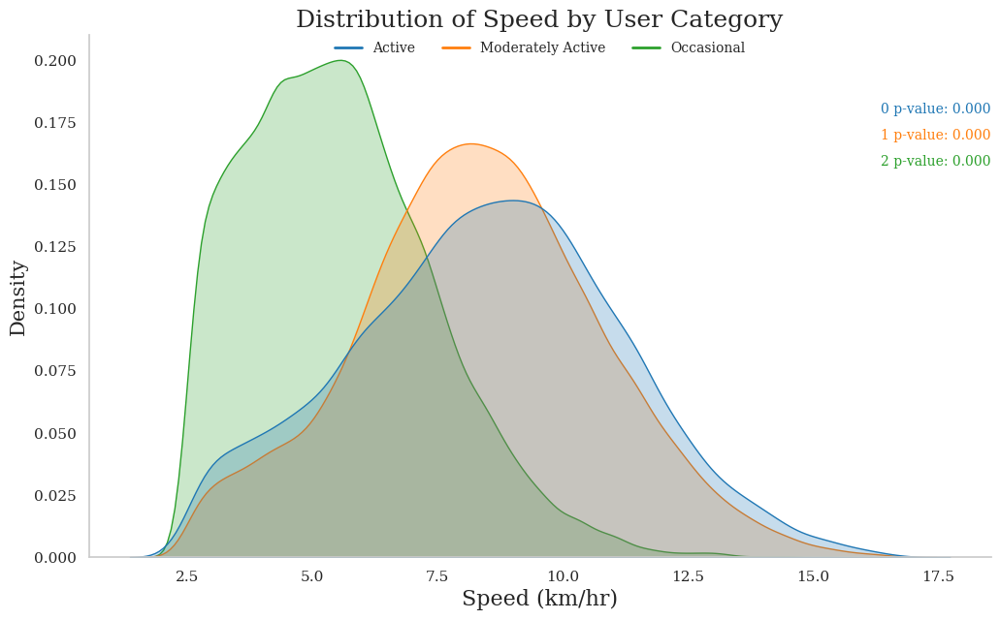

In [234]:
import seaborn as sns
from scipy import stats
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
# Assuming 'trips' DataFrame is defined with 'SpeedKmHrHav' and 'UserCategory'
# set seaborn font writing
 

sns.set_style("whitegrid", {'axes.facecolor': 'white', 'grid.color': 'lightgray', 'font.family':'serif'})
colors = ['#1f77b4', '#ff7f0e', '#2ca02c']

plt.figure(figsize=(12, 7))
ax = sns.kdeplot(data=trips, x='SpeedKmHrHav', hue='UserCluster', fill=True, palette=colors, common_norm=False)

# Customize the legend with lines instead of the default patches
handles = [mlines.Line2D([], [], color=color, label=label, linewidth=2) for color, label in zip(colors, ['Active', 'Moderately Active', 'Occasional'])]

# Customize the legend
new_labels = ['Active', 'Moderately Active', 'Occasional']
ax.set_title('Distribution of Speed by User Category', fontdict={'fontsize': 18})
ax.legend(title='', labels=new_labels, loc='upper center', ncol=3, frameon=False, handles=handles, bbox_to_anchor=(0.5, 1.01), fontsize=10)
ax.grid(False)

ax.set_xlabel('Speed (km/hr)', fontsize=16)
ax.set_ylabel('Density', fontsize=15)

# Perform Shapiro-Wilk test for each user category
for i, category in enumerate(sorted(trips['UserCluster'].unique())):
    category_data = trips[trips['UserCluster'] == category]['SpeedKmHrHav']
    if len(category_data) > 5000:
        category_data = category_data.sample(5000, random_state=1)
    shapiro_test = stats.shapiro(category_data)
    p_value = shapiro_test.pvalue
    color = colors[i]  # Get the corresponding color for the user group
    ax.annotate(f'{category} p-value: {p_value:.3f}', xy=(1, 0.85-(i*0.05)), xycoords='axes fraction', fontsize=10, color=color, backgroundcolor='white', ha='right')

sns.despine()  # Optional: Remove the top and right spines
plt.show()


In [235]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np
from scipy import stats

# Assuming 'trips' DataFrame is defined with 'UserCategory' and 'SpeedKmHrHav' columns

# Define colors for the plot
colors = ['#1f77b4', 'orange', '#2ca02c']  # Different colors for each UserCategory
max_speed = trips['SpeedKmHrHav'].max() 
# Create an empty figure
fig = go.Figure()

# Loop through each category to add KDE plot
for i, (category, color) in enumerate(zip(sorted(trips['UserCategory'].unique()), colors)):
    category_data = trips[trips['UserCategory'] == category]['SpeedKmHrHav']
    
    # Calculate the KDE
    kde = stats.gaussian_kde(category_data)
    x_range = np.linspace(category_data.min(), category_data.max(), 1000)
    kde_values = kde.evaluate(x_range)
    
    # Add trace for the KDE
    fig.add_trace(go.Scatter(x=x_range, y=kde_values, fill='tozeroy', name=category,
                             line=dict(color=color), opacity=0.0))
    
    # Perform Shapiro-Wilk test (sample size limited to 5000)
    shapiro_test = stats.shapiro(category_data.sample(min(5000, len(category_data))))
    p_value = shapiro_test.pvalue
    
    # Add annotation for Shapiro-Wilk test p-value
    fig.add_annotation(x=0.95, y=0.95-(i*0.05), text=f'{category} Norm p-value: {p_value:.3f}',
                       showarrow=False, xref="paper", yref="paper",
                       font=dict(size=12, color=color), bgcolor="rgba(255, 255, 255, 0.9)",
                       xanchor='right')

# Update layout
fig.update_layout(
    margin=dict(l=20, r=20, t=100, b=20),
    title=dict(font = dict(size=22),text='Speed KDE by User Category', x=0.5, xanchor='center', y = 0.98),
    xaxis_title_text='Speed (km/hr)',
    yaxis_title_text='Density',
    xaxis_range=[2, max_speed + 1],
    xaxis_showgrid=False,
    height=600, width=900,
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="center", x=0.5),
    bargap=0.05,  # Add some space between bars
    barmode='overlay'  # Enable overlay mode for histograms
)
fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))
fig.show()


In [236]:
# describe the SpeedKmHr for each UserCategory
trips.groupby('UserCluster')['SpeedKmHrHav'].describe()


,count,mean,std,min,25%,50%,75%,max
UserCluster,,,,,,,,
0,17257.0,8.444601,2.716392,2.502408,6.555192,8.530095,10.301769,16.582255
1,33806.0,8.306899,2.454576,2.500106,6.693416,8.293101,9.909614,16.558749
2,31189.0,5.544992,1.897509,2.500215,4.086237,5.366664,6.735266,16.122984


In [237]:
# perform anova for difference between groups for HaversineDistance
#pairwise_results_sp = pg.pairwise_tests(data=trips, dv='SpeedKmHrHav', between='UserCategory', padjust='bonf', alpha = 0.05, parametric=False, effsize="hedges").round(4)
#pairwise_results_sp

In [238]:
distance_speed_melted

,UserCategory,Metric,Value
0,Active Users,HaversineDistance,2.683367
1,Moderately Active Users,HaversineDistance,2.574681
2,Occasional Users,HaversineDistance,2.571363
3,Active Users,SpeedKmHrHav,8.573836
4,Moderately Active Users,SpeedKmHrHav,7.819077
5,Occasional Users,SpeedKmHrHav,6.608805


#### speed and distance analysis
Active users complete longer trips at higher speeds, indicating a more experienced or committed user group. This insight can inform targeted marketing strategies or user engagement initiatives to retain and attract active users. Additionally, the analysis of speed and distance can provide valuable insights into user behavior and preferences, guiding the design of bike-sharing services and infrastructure to better meet user needs. Here are several analytical approaches and methodologies to leverage speed and distance data for user insights: 

### 1. User Segmentation
Segment users based on their average trip distance and speed to identify distinct user groups with different usage patterns:
- **Long-Distance vs. Short-Distance Users**: Compare the behavior and preferences of users who complete longer trips at higher speeds against those who prefer shorter trips at lower speeds. This segmentation can help tailor services to meet the needs of different user groups.
- **Speed-Based Segments**: Segment users based on their average speed to identify groups of fast riders and leisurely riders. This can inform infrastructure planning and service design to accommodate different riding styles.

### 2. Usage Pattern Analysis
Analyze the usage patterns of individual users or user segments over time to identify trends, such as:
- **Temporal Patterns**: Identify peak usage times for different user segments based on speed and distance. Are there differences in usage patterns during peak vs. off-peak hours?
- **Spatial Patterns**: Examine if certain users prefer longer or faster trips in specific areas or for specific trip purposes, such as commuting or leisure.

### 3. Comparative Analysis
Perform a comparative analysis of bike-sharing usage for different user groups to determine:
- **Mode Preference by User Segment**: Do users who complete longer or faster trips show a stronger preference for bike-sharing over other modes of transport? This could indicate a specific user group that values the speed and convenience of bike-sharing.
- **Impact of Distance on Usage**: For users with similar speed patterns, does the average trip distance correlate with higher or lower bike-sharing usage? This can inform infrastructure planning and station placement.

### 4. Behavior Over Time
Investigate how individual or segmented user behaviors change over time with respect to:
- **Changes in Trip Characteristics**: Do users tend to complete longer or faster trips over time, indicating a shift in preferences or behavior? This can inform service adjustments and user engagement strategies.
- **Seasonal or Weather-Related Patterns**: Analyze if and how user patterns change with seasons or weather conditions, particularly for those who use bike-sharing for commuting or recreational purposes.

### Methodological Considerations:
- **Data Quality and Granularity**: Verify the accuracy and granularity of the speed and distance data, especially for longitudinal analyses, to ensure meaningful insights.
- **Statistical Significance**: When comparing groups or trends, ensure statistical tests are used to determine the significance of observed patterns.
- **User Anonymity**: Ensure the analysis respects user privacy and data protection laws, anonymizing user IDs where necessary.

### Implementation Approach:
To implement these analyses, you could use a combination of data manipulation, statistical testing, and machine learning clustering techniques (e.g., k-means for segmentation) within a Python environment using libraries such as Pandas, NumPy, Scikit-learn, and Seaborn/Matplotlib for visualization.

By leveraging speed and distance data, you can gain valuable insights into user behavior and preferences related to bike-sharing, enabling more personalized and efficient transportation solutions.


In [239]:
trips.columns

Index(['StartTime', 'EndTime', 'UserId', 'latitudeStart', 'longitudeStart',
       'nameStart', 'latitudeEnd', 'longitudeEnd', 'nameEnd',
       'StartHubClusterId', 'EndHubClusterId', 'StartClusterName',
       'EndClusterName', 'StartClusterLatitude', 'StartClusterLongitude',
       'EndClusterLatitude', 'EndClusterLongitude', 'HaversineDistance',
       'Month', 'StartHour', 'Weekday', 'TripDurationMin', 'TripDurationHr',
       'SpeedKmHr', 'RoundTrip', 'Route', 'YearMonth', 'DurationGroup',
       'StartTimeUpdated', 'TotalDurationMin', 'TripDistanceKm',
       'TotalWalkingTimeMin', 'TotalTransitTimeMin', 'Changes',
       'PickupStationProximity', 'DropoffStationProximity', 'SpeedKmHrHav',
       'SpeedKmHrP', 'DistanceType', 'UserCategory', 'UserCluster', 'DayType'],
      dtype='object')

In [240]:
# perform pairwise comparisons using pingouin.pairwise_tests on trips_melted for the 'DurationType' and 'Changes' columns
# pairwise_results = pg.pairwise_tests(data=trips_melted, dv='Duration', between=['Changes','DurationType'], padjust='bonf')
# pairwise_results['p-unc'] = pairwise_results['p-unc'].apply(lambda x: format(x, '.4f'))
# pairwise_results['p-corr'] = pairwise_results['p-corr'].apply(lambda x: format(x, '.4f')) 
# pairwise_results

In [241]:
# reset the index of the trips DataFrame
trips.reset_index(drop=True, inplace=True)

In [242]:
# save trips to csv with name dr_oneway_spacial.csv

trips.to_csv('../data/processed/dr_oneway_spacial.csv', index=False)